<a href="https://colab.research.google.com/github/WilliamDubois/glo7030-labs/blob/master/Laboratoire%203.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Rappel Google Colab

Tout d'abord, sélectionnez l'option GPU de Colab avec *Edit > Notebook settings* et sélectionner GPU comme Hardware accelerator.
Installer ensuite deeplib avec la commande suivante:

In [2]:
!pip install git+https://github.com/ulaval-damas/glo4030-labs.git

  Cloning https://github.com/ulaval-damas/glo4030-labs.git to /tmp/pip-req-build-b885j_ci
  Running command git clone --filter=blob:none --quiet https://github.com/ulaval-damas/glo4030-labs.git /tmp/pip-req-build-b885j_ci
  Resolved https://github.com/ulaval-damas/glo4030-labs.git to commit c18815c2c3080b82b6db4c66f66a57367149a723
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.4/214.4 kB 23.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 90.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 76.2 MB/s eta 0:00:00
  Created wheel for deeplib: filename=deeplib-0.1-py3-none-any.whl size=10542 sha256=06f6a23b6a5c080b42aa3704ccd7683f8dd6950f7a90a119a572eb56106cd868
  Stored in directory: /tmp/pip-ephem-wheel-cache-_xuy13ko/wheels/9f/29/ed/25822e0088ad9c46b352ed51c58696b9d13fbc94e1db2ac759
Successfully built deeplib


# Laboratoire 3: Optimisation

## Partie 1: Fonctions d'optimisation

Dans cette section, vous testerez différentes fonctions d'optimisation et observerez leurs effets sur l'entraînement.

In [3]:
%matplotlib inline

from collections import defaultdict
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.nn.init as init
import poutyne as pt

from deeplib.history import History
from deeplib.datasets import train_valid_loaders, load_cifar10

from torchvision.transforms import ToTensor

from deeplib.net import CifarNet

from deeplib.datasets import train_valid_loaders, load_mnist, load_cifar10
from deeplib.training import train, validate_ranking, test
from deeplib.visualization import show_2d_function, show_optimization, show_worst, show_random, show_best

plt.rcParams['figure.dpi'] = 150

### 1.1 Un exemple jouet

On va commencer par explorer les effets des variantes de SGD avec un exemple jouet. L'exemple jouet va consister en une régression linéaire simple en 2 dimensions avec laquelle on sera en mesure de visualiser l'impact des différentes variantes de SGD. En effet, dans cette section, on va jouer avec trois paramètres de SGD: le taux d'apprentissage, le momentum et l'accélération de Nesterov.

Initialisations notre jeu de données jouet qui va contenir seulement 3 points en 2 dimensions ainsi que 3 valeurs à régresser.

In [3]:
x = torch.tensor([[1,1],[0,-1],[2,.5]], dtype=torch.float32)
y = torch.tensor([[-1.], [3], [2]], dtype=torch.float32)

Lors d'une régression linéaire, on souhaite trouver des poids $w^*$ qui minimise pour chaque exemple $(x_i, y_i)$ la perte quadratique entre $x_i \cdot w$ et $y_i$. Mathématiquement, voici la fonction que l'on souhaite optimiser:
$$F(w) = \frac{1}{n} \sum_{i=1}^{n} (x_i \cdot w - y_i)^2$$
On souhaite donc trouver les poids optimaux $w^*$ qui minimise $F(w)$.
$$w^* = \text{argmin}_w F(w)$$
La cellule ci-dessous est cette fonction objectif en fonction des paramètres $w$ que l'on souhaite trouver.

In [4]:
def objective_function(w):
    return torch.mean((x @ w - y) ** 2, dim=0)

Comme vous vous en rappelez peut-être, la solution d'une régression linéaire a une forme analytique qui est la suivante.
$$w^* = (X^TX)^{-1}X^TY$$
La cellule ci-dessous trouve la solution pour notre problème jouet en utilisant cette formule.

In [5]:
w_opt = torch.inverse(x.T @ x) @ x.T @ y

Nous allons utiliser la fonction `show_2d_function` de la librairie `deeplib`. La librairie `deeplib` est une libraire écrite spécialement pour les notebook de ce cours. La fonction `show_2d_function` permet de visualiser notre fonction objectif avec des courbes de niveau. Les deux axes correspondent à différentes valeurs pour les 2 poids respectifs de $w$ pour notre régression linéaire en 2 dimensions. La couleur des courbes de niveau donne la valeur de la fonction objectif. L'étoile rouge correspond à $w^*$, notre valeur optimale des poids.

/usr/local/lib/python3.12/dist-packages/torch/functional.py:505: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:4317.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


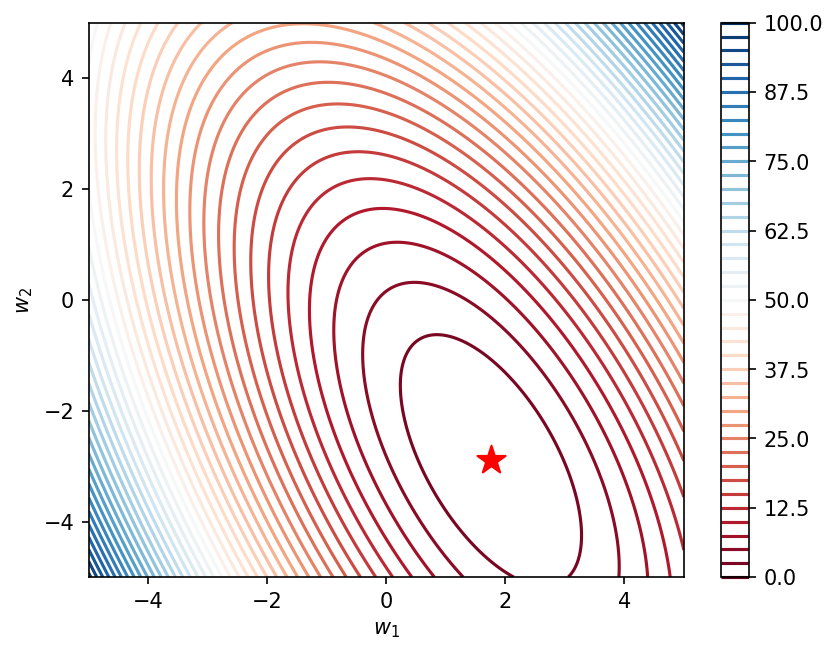

In [6]:
show_2d_function(objective_function, optimal=w_opt)

Les prochaines cellules définissent deux fonctions.

La première fonction se charge d'optimiser notre fonction objectif à la manière des réseaux de neurones en utilisant l'optimiseur SGD de PyTorch. La fonction retourne l'historique des poids $w$ de chaque itération ainsi que l'historique des valeurs de perte. Des commentaires dans cette fonction ont été laissés afin que vous puissiez comprendre le déroulement de l'optimisation.

In [7]:
def optimize(learning_rate, momentum, nesterov, nb_iter=20):
    """
    Optimise la fonction objectif à la manière de PyTorch avec l'optimiseur SGD.

    Args:
        learning_rate: Le taux d'apprentissage.
        momentum: La valeur du momentum.
        nesterov: Si l'accélération de Nesterov est désirée.
        nb_iter: Le nombre d'itérations effectué.

    Returns:
        Tuple `(w_history, loss_history)` où `w_history` correspond à
        l'historique des poids lors de l'optimisation et `loss_history`
        correspond à l'historique de la valeur de la fonction objectif
        ou fonction de perte dans le cadre des réseaux de neurones.
    """
    torch.manual_seed(42)

    # Notre réseau: une couche linéaire sans biais. Essentiellement, 2 poids.
    neuron = nn.Linear(2, 1, bias=False)

    # La fonction de perte quadratique.
    loss_function = nn.MSELoss()

    # Initialise l'optimiseur SGD
    optimizer = optim.SGD(neuron.parameters(), lr=learning_rate, momentum=momentum, nesterov=nesterov)

    # À la différence des réseaux de neurones, on ne divise pas en epochs
    # et en batchs étant donné que notre jeu de données contient seulement
    # 3 points et que notre problème est convexe et donc résoluble avec une
    # simple descente de gradient. On fera donc un certain nombre d'itérations
    # pour trouver la solution du problème. On pourrait voir une itération comme
    # un epoch avec une seule batch contenant le jeu de données entier.
    # Pour chaque itération, on y va à
    # la manière des réseaux de neurones:
    # - On effectue une prédiction;
    # - On calcule notre perte;
    # - On fait la rétropropagation (backpropagation) via la méthode backward();
    # - On met à jour les poids avec l'optimiseur.
    w_history = []
    loss_history = []
    for t in range(nb_iter):
        y_pred = neuron(x)
        loss = loss_function(y_pred, y)
        w_history.append(neuron.weight.squeeze(0).detach().clone().numpy())
        loss_history.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    return w_history, loss_history

La deuxième fonction trace des graphiques permettant de visualiser l'optimisation effectuée par la première fonction. La fonction ne fait qu'appeler la fonction `show_optimization` définie dans `deeplib` en lui passant en paramètre les historiques retournées par la fonction d'optimisation, la fonction objectif ainsi que les paramètres optimaux que nous avons calculés.

In [8]:
def show_objective_optimization(w_history, loss_history, **kwargs):
    return show_optimization(w_history, loss_history, objective_function, optimal=w_opt, **kwargs)

On va utiliser ces deux fonctions pour pouvoir visualiser l'impact de trois paramètres de SGD: le taux d'apprentissage, le momentum et l'accélération de Nesterov.

In [9]:
learning_rate = 0.3
momentum = 0
nesterov = False

Optimisons maintenant notre fonction avec les valeurs ci-dessus.

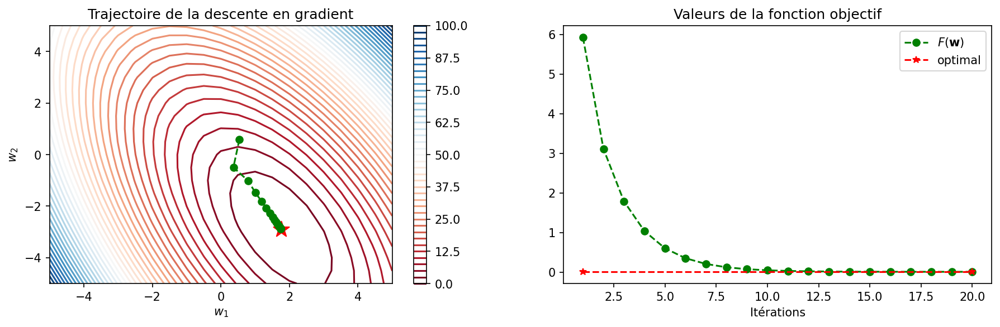

In [10]:
w_history, loss_history = optimize(learning_rate, momentum, nesterov)
show_objective_optimization(w_history, loss_history)

On voit qu'après 10 itérations, l'optimisation a relativement convergé.

#### Exercices

Pour les exercices ci-dessous, vous pouvez utiliser des fonctions comme [`numpy.linspace`](https://numpy.org/doc/stable/reference/generated/numpy.linspace.html), [`numpy.logspace`](https://numpy.org/doc/stable/reference/generated/numpy.logspace.html) ou [`numpy.geomspace`](https://numpy.org/doc/stable/reference/generated/numpy.geomspace.html) permettant d'obtenir une liste de valeurs à tester.

- Testez différentes valeurs entre 0 et 1 du taux d'apprentissage en complétant la cellule ci-dessous.

/usr/local/lib/python3.12/dist-packages/deeplib/visualization.py:306: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2, figsize=(14.5, 4))


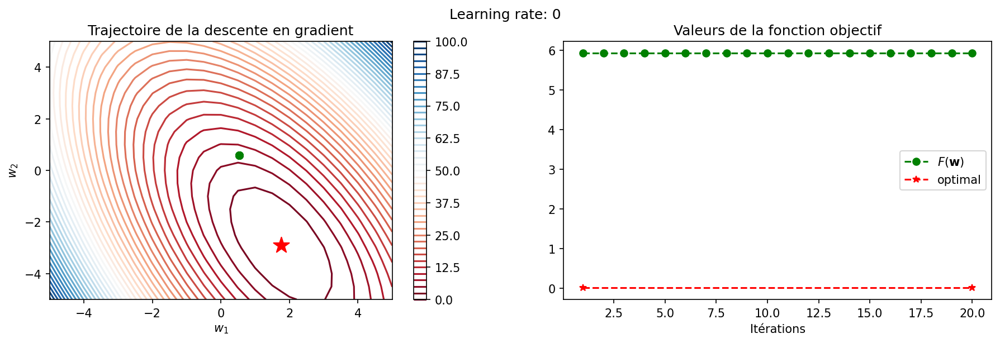

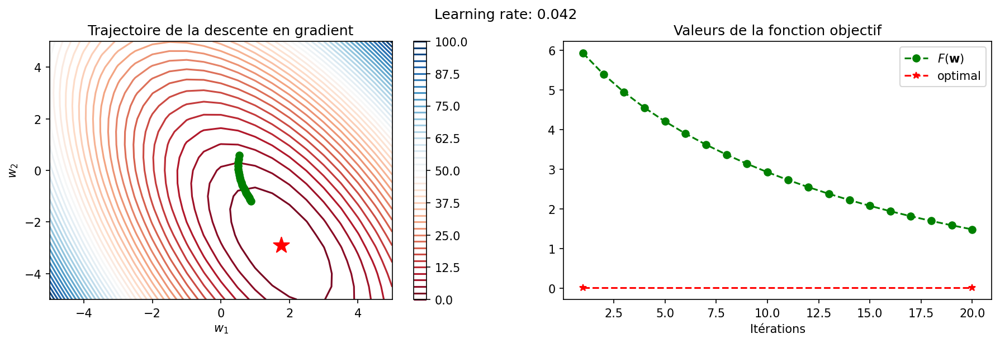

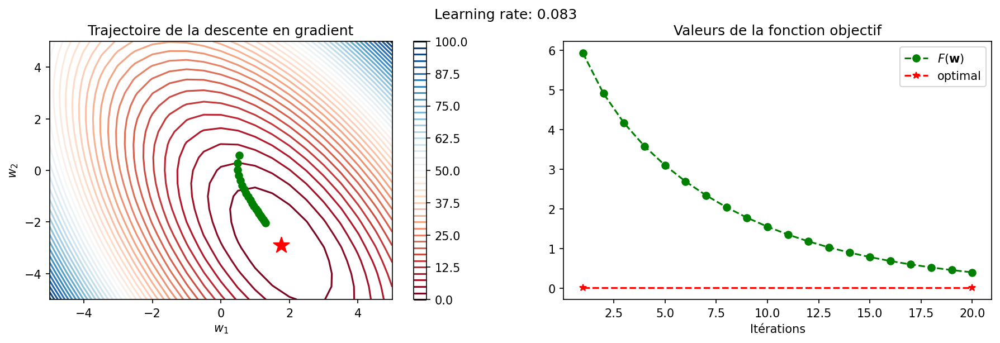

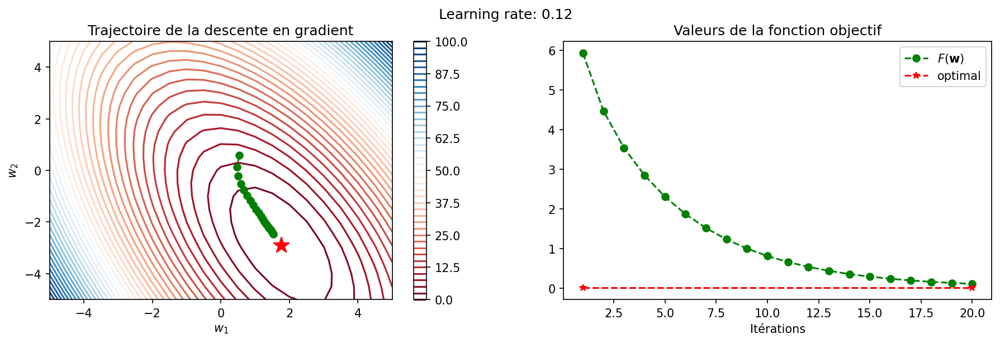

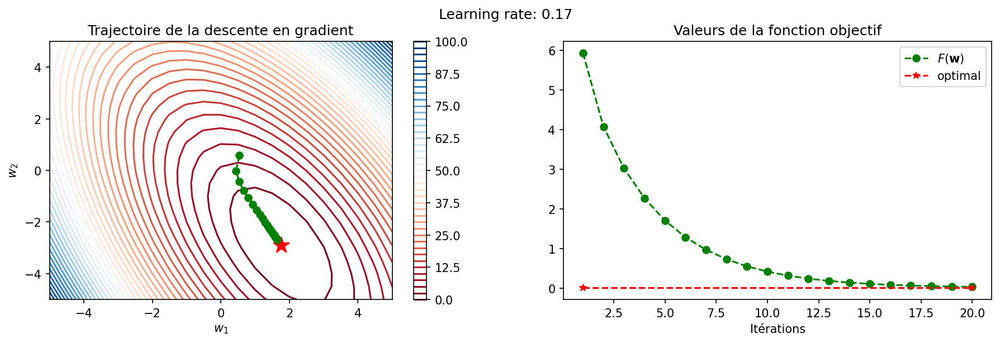

...

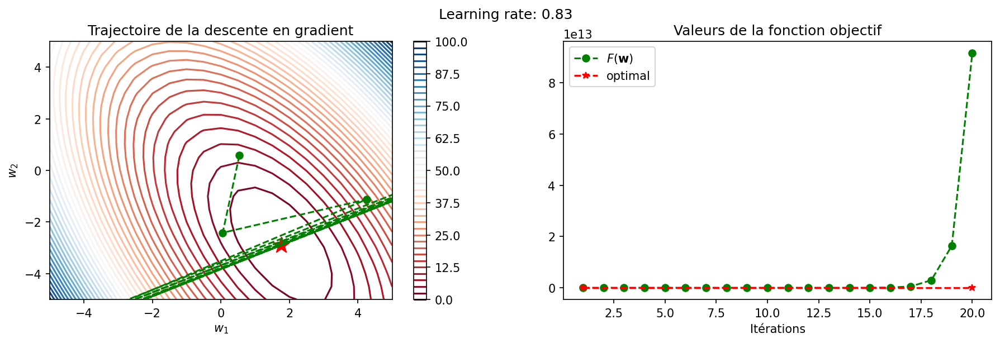

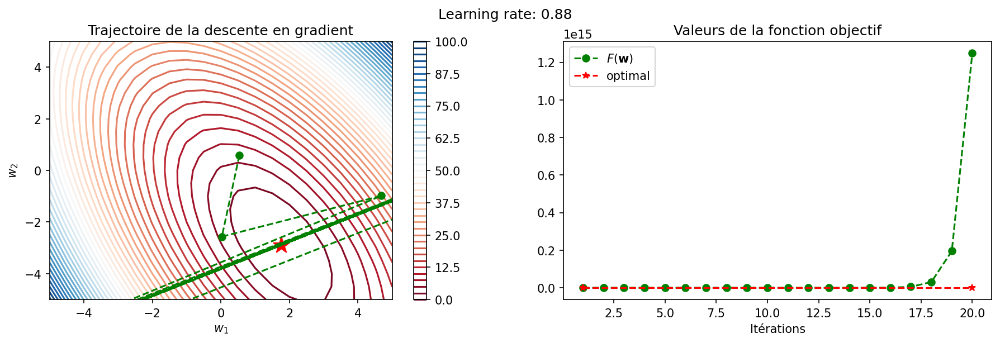

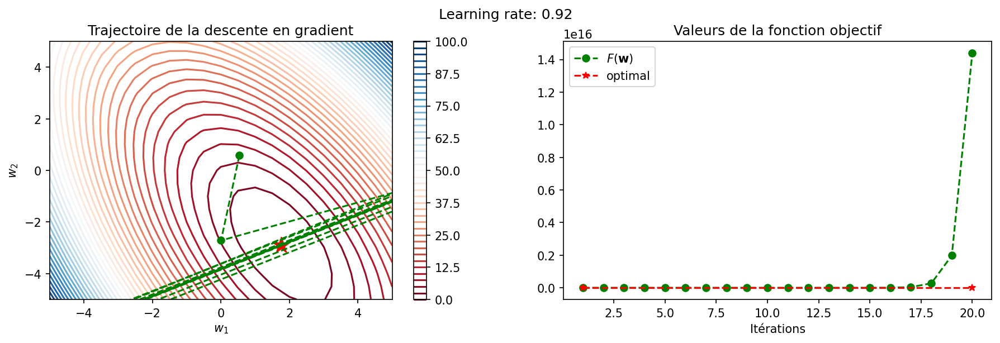

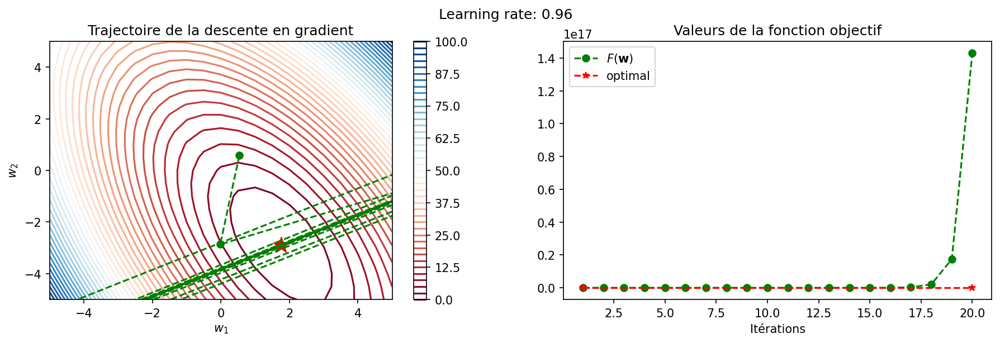

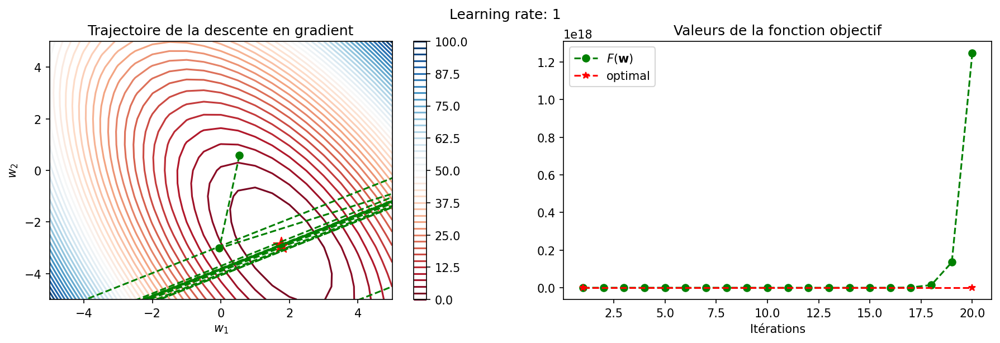

In [11]:
momentum = 0.
nesterov = False
for learning_rate in np.linspace(0, 1, 25): # TODO à compléter avec différentes valeurs
    w_history, loss_history = optimize(learning_rate, momentum, nesterov)
    show_objective_optimization(w_history, loss_history, title=f"Learning rate: {learning_rate:.2g}")

- Testez différentes valeurs entre 0 et 1 pour le momentum en complétant la cellule ci-dessous.

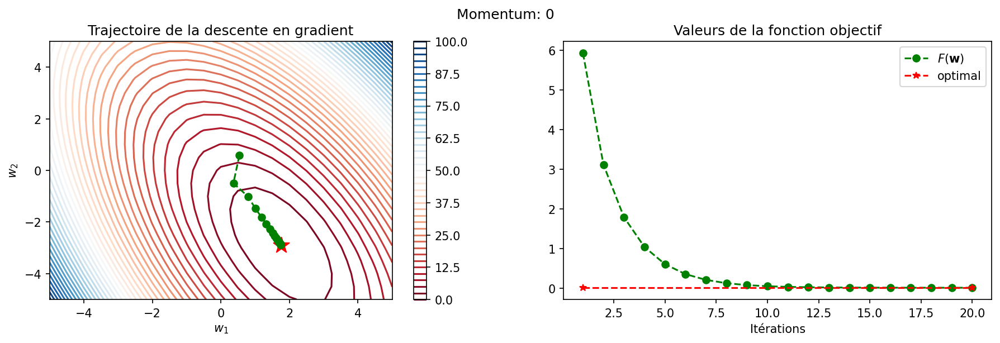

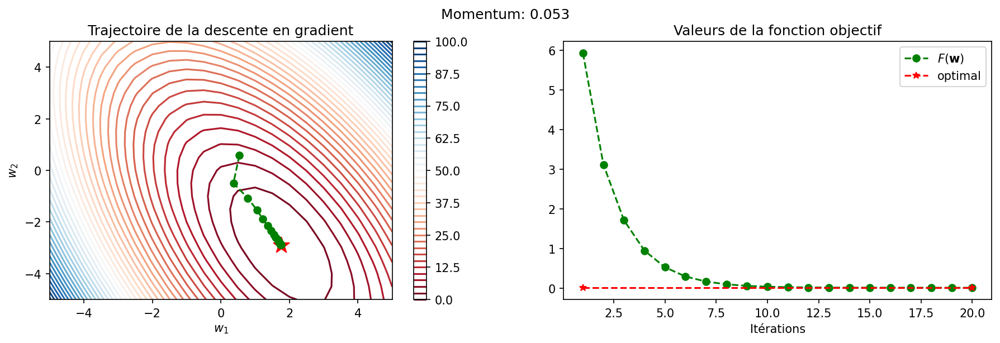

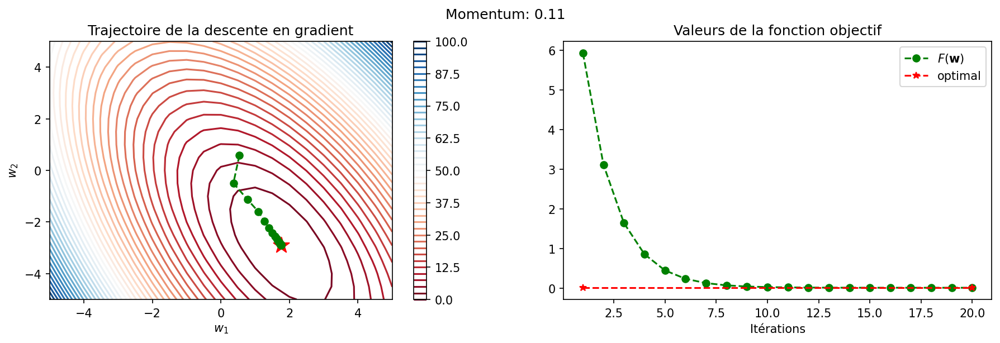

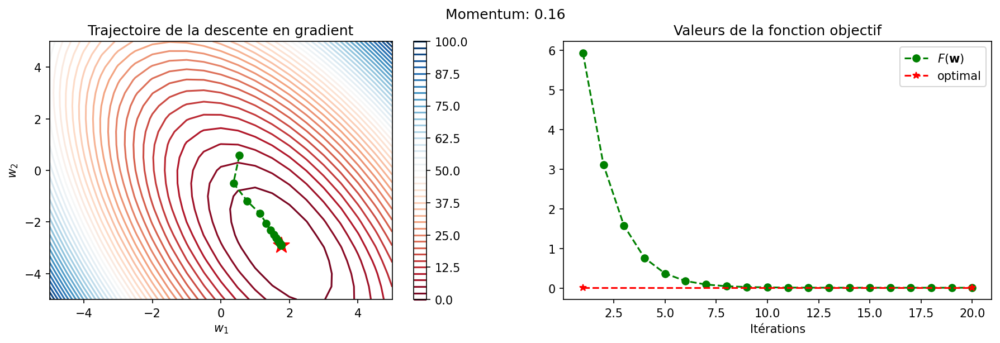

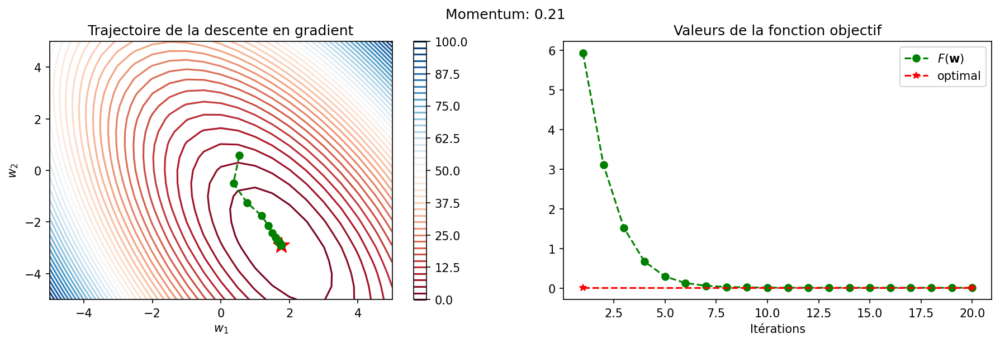

...

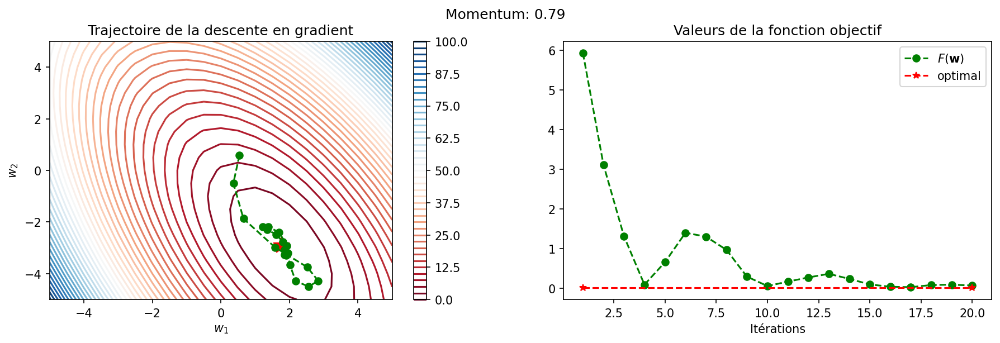

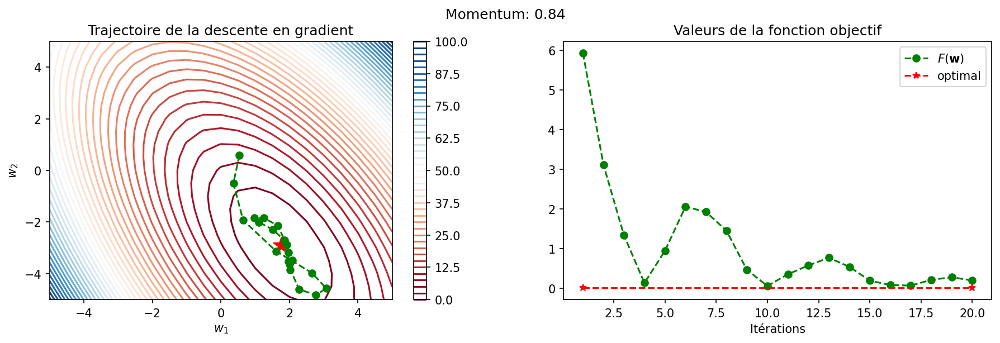

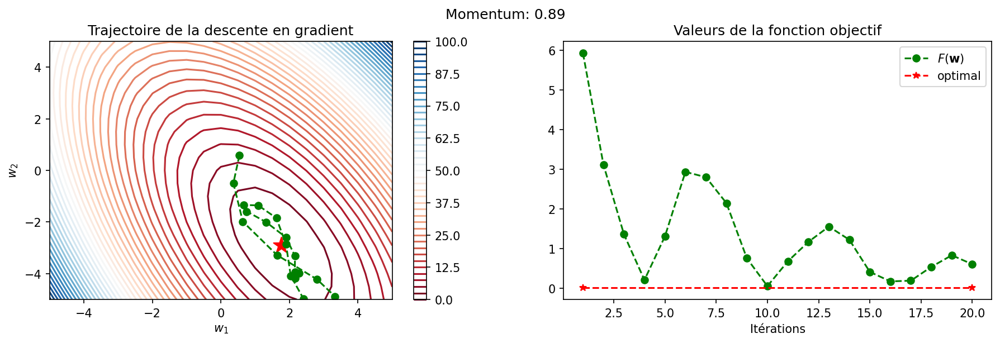

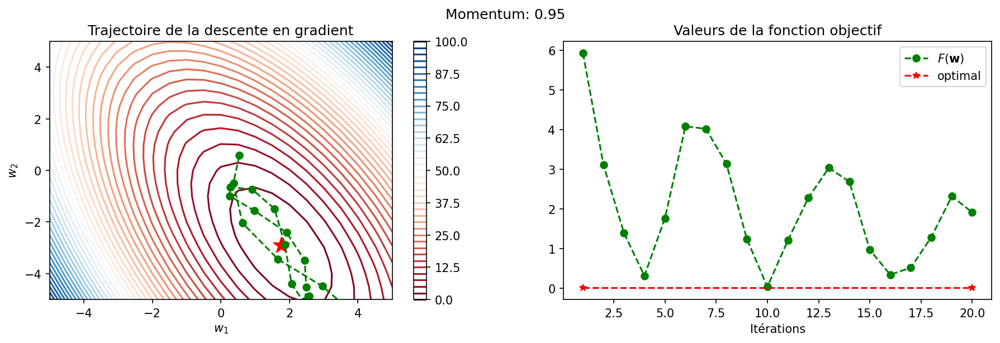

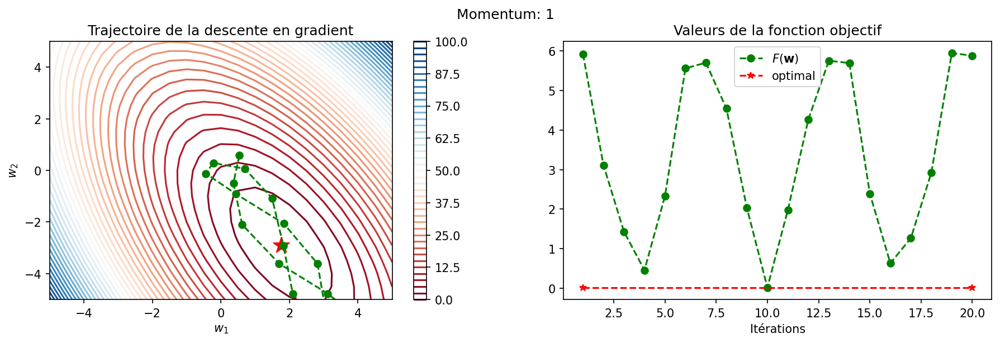

In [12]:
learning_rate = 0.3
nesterov = False
for momentum in np.linspace(0,1,20): # TODO à compléter avec différentes valeurs
    w_history, loss_history = optimize(learning_rate, momentum, nesterov)
    show_objective_optimization(w_history, loss_history, title=f"Momentum: {momentum:.2g}")

- Testez différentes valeurs entre 0 et 1 pour le momentum avec l'accélération de Nesterov en complétant la cellule ci-dessous.

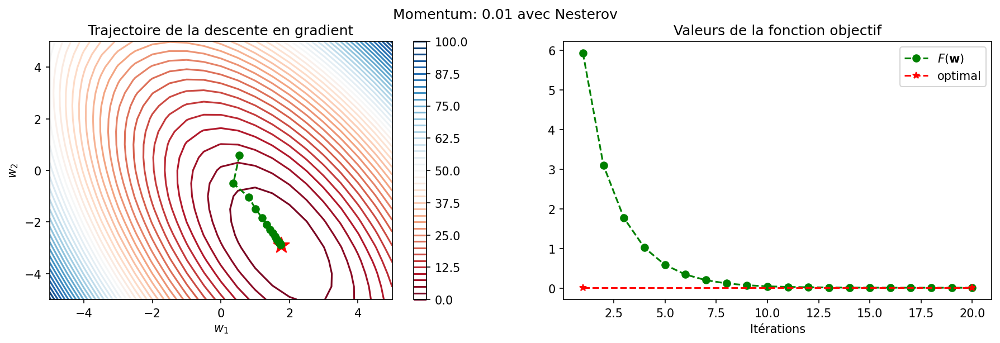

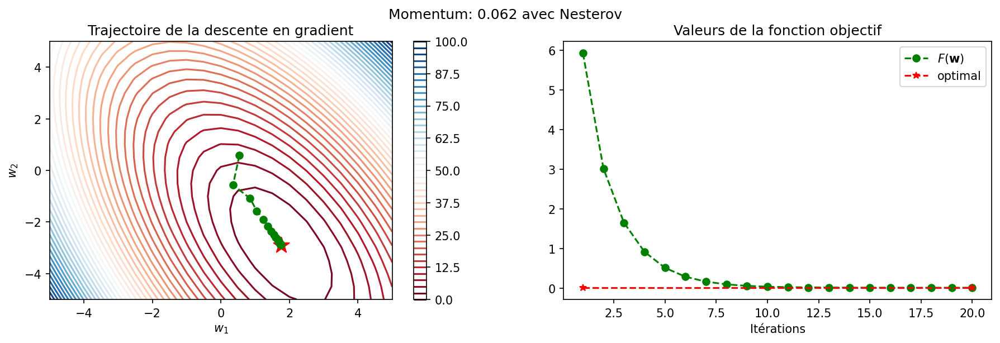

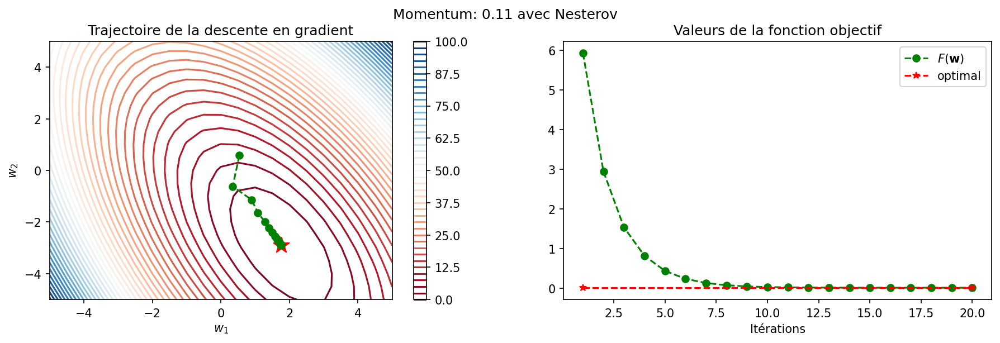

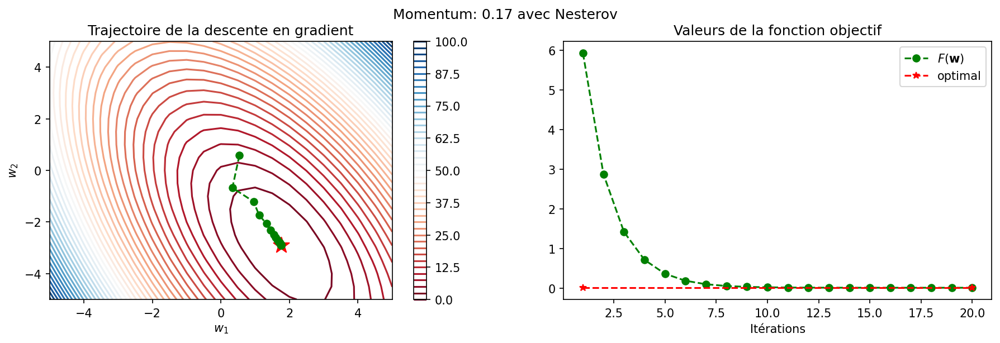

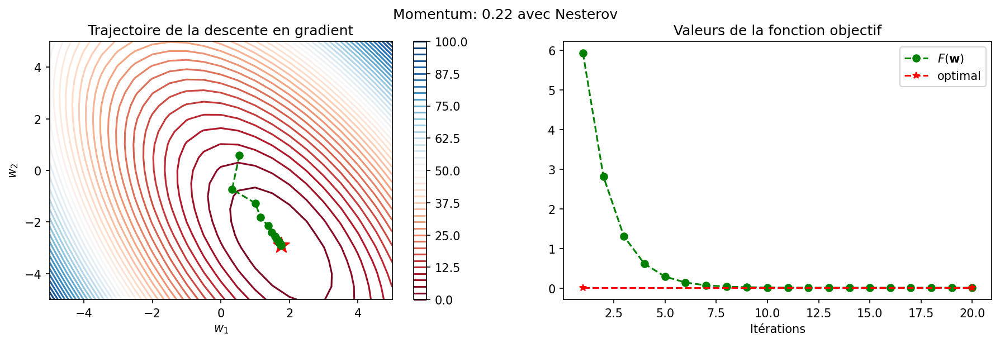

...

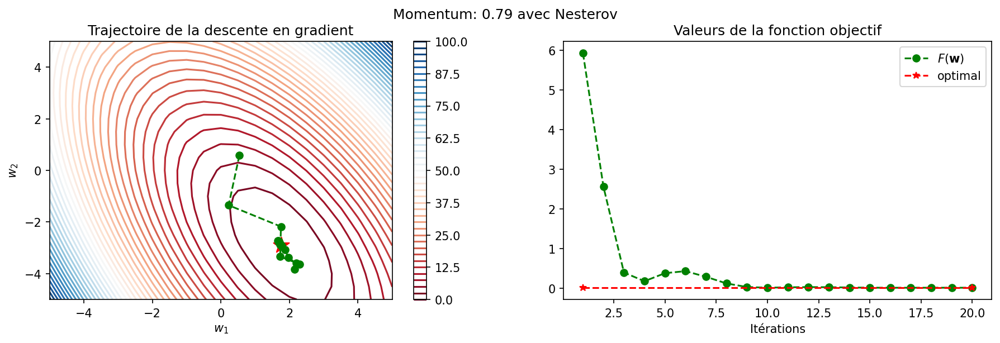

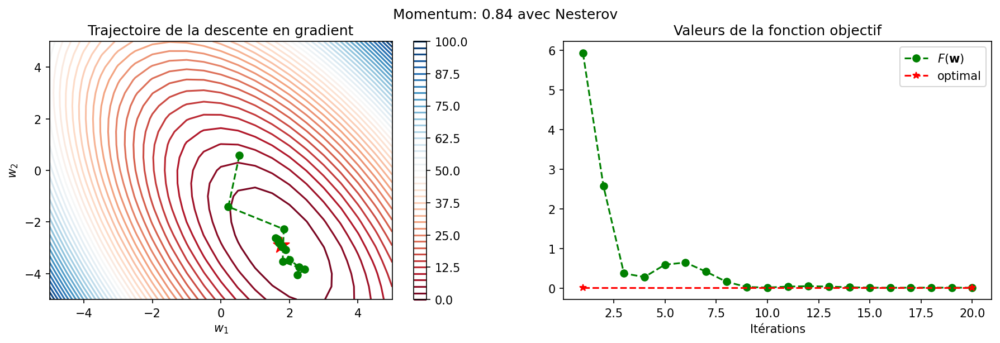

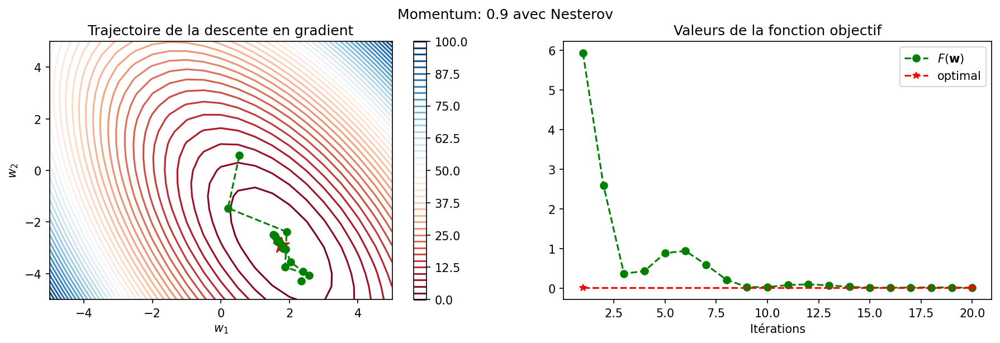

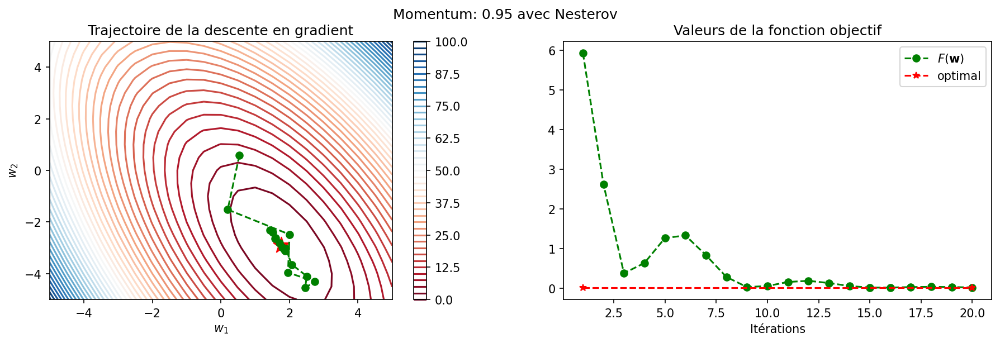

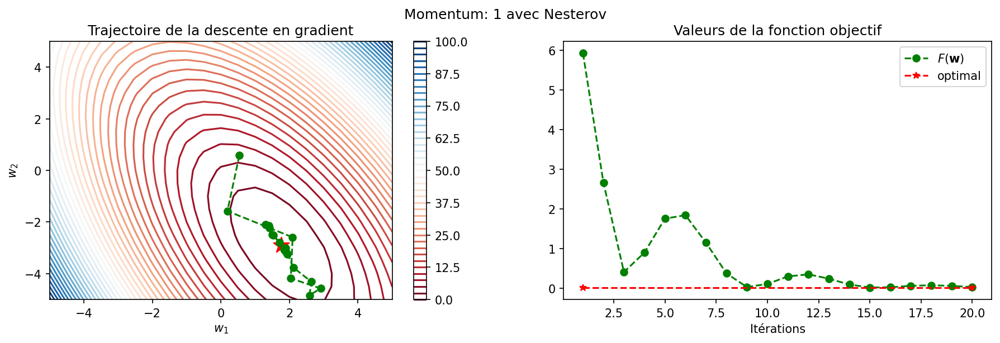

In [14]:
learning_rate = 0.3
nesterov = True
for momentum in np.linspace(0.01,1,20): # TODO à compléter avec différentes valeurs
    w_history, loss_history = optimize(learning_rate, momentum, nesterov)
    show_objective_optimization(w_history, loss_history, title=f"Momentum: {momentum:.2g} avec Nesterov")

#### Questions
- Que pouvons-nous remarquer sur l'impact du taux d'apprentissage sur l'optimisation?
Un taux d'apprentissage trop faible n'apprendra pas, alors qu'un taux trop élevé empêchera la convergence en corrigeant trop fortement le système.
- Que pouvons-nous remarquer sur l'impact du momentum sur l'optimisation?
Le momentum peut accélérer l'apprentissage lorsque son niveau est bien choisi. Toutefois, un momentum trop élevé fera osciller les paramètres autour des paramètres optimaux sans converger.
- Que pouvons-nous remarquer sur l'impact de l'accélération de Nesterov sur l'optimisation?
L'accélération de Nesterov ajoute de la robustesse à l'utilisation du momentum, afin de limiter les oscillations et favoriser la convergence même avec un momentum très élevé.

### 1.2 Un exemple plus près de la réalité

Testons maintenant différents optimiseurs sur un vrai réseau de neurones avec un vrai jeu de données. Comme dans les labos précédents, on utilise le jeu de données CIFAR10 avec un simple réseau à convolution.

Initialisons le jeu de données et quelques hyperparamètres qui vont rester constants.

In [4]:
cifar_train, cifar_test = load_cifar10()

100%|██████████| 170M/170M [00:19<00:00, 8.58MB/s]


In [16]:
batch_size = 128
lr = 0.01
n_epoch = 10

Pour le reste de ce notebook et dans les prochains laboratoires, nous allons utiliser la fonction `train` qui est définie dans la librairie `deeplib`. La fonction utilise la librairie [Poutyne](https://poutyne.org). Comme vu dans le laboratoire 1, Poutyne nous donne un meilleur affichage de l'évolution de l'entraînement comparativement à notre boucle d'entraînement personnalisée que nous avions fait à la main. Comme on va le voir plus loin, l'utilisation de Poutyne implique nous allons devoir utiliser des callbacks de Poutyne pour les horaires d'entraînement.

#### Exercice

 - Comparez trois différentes stratégies d'optimisation:
1. [SGD](http://pytorch.org/docs/master/optim.html#torch.optim.SGD)
2. SGD + Momentum accéléré de Nesterov
3. [Adam](http://pytorch.org/docs/master/optim.html#torch.optim.Adam)

Commençons par l'entraîner avec SGD (sans momentum ni accélération de Nesterov).

/usr/local/lib/python3.12/dist-packages/poutyne/framework/metrics/decomposable.py:59: UserWarning: Converting a tensor with requires_grad=True to a scalar may lead to unexpected behavior.
Consider using tensor.detach() first. (Triggered internally at /pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:836.)
  values = [float(output)]


Epoch:  1/10 Train steps: 313 Val steps: 79 12.21s loss: 2.297451 acc: 12.737500 val_loss: 2.288542 val_acc: 18.240000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.07s loss: 2.232649 acc: 22.542500 val_loss: 2.082366 val_acc: 26.000000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.68s loss: 2.015583 acc: 27.907500 val_loss: 1.973571 val_acc: 30.290000
Epoch:  4/10 Train steps: 313 Val steps: 79 8.73s loss: 1.917724 acc: 32.385000 val_loss: 1.885317 val_acc: 32.800000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.85s loss: 1.829046 acc: 35.635000 val_loss: 1.900394 val_acc: 33.260000
Epoch:  6/10 Train steps: 313 Val steps: 79 8.27s loss: 1.752312 acc: 38.355000 val_loss: 1.698207 val_acc: 40.360000
Epoch:  7/10 Train steps: 313 Val steps: 79 8.71s loss: 1.683569 acc: 40.350000 val_loss: 1.636882 val_acc: 41.820000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.77s loss: 1.623604 acc: 42.660000 val_loss: 1.594104 val_acc: 43.300000
Epoch:  9/10 Train steps: 313 Val steps: 79 8.35s loss:

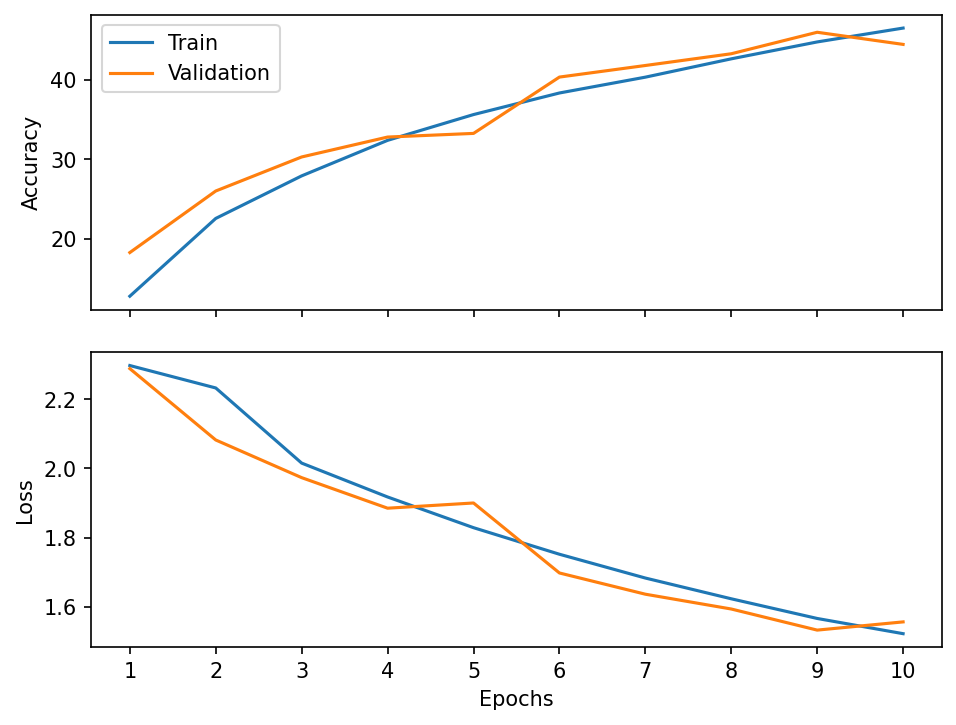

Test steps: 79 1.42s test_loss: 1.537803 test_acc: 45.280000                                
Exactitude en test: 45.28


In [17]:
model = CifarNet()
model.cuda()
optimizer = optim.SGD(model.parameters(), lr=lr)
history_sgd = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history_sgd.display()
print('Exactitude en test: {:.2f}'.format(test(model, cifar_test, batch_size)))

 - Complétez cette cellule pour entraîner avec SGD + Momentum accéléré de Nesterov. Utilisez un momentum de 0.9.

Epoch:  1/10 Train steps: 313 Val steps: 79 8.37s loss: 1.854580 acc: 33.590000 val_loss: 1.600288 val_acc: 42.300000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.76s loss: 1.412696 acc: 49.895000 val_loss: 1.320184 val_acc: 52.980000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.84s loss: 1.231518 acc: 56.800000 val_loss: 1.233657 val_acc: 56.370000
Epoch:  4/10 Train steps: 313 Val steps: 79 8.90s loss: 1.099650 acc: 61.430000 val_loss: 1.098460 val_acc: 61.100000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.13s loss: 0.993079 acc: 65.425000 val_loss: 1.032616 val_acc: 64.260000
Epoch:  6/10 Train steps: 313 Val steps: 79 9.95s loss: 0.905644 acc: 68.627500 val_loss: 1.010948 val_acc: 65.130000
Epoch:  7/10 Train steps: 313 Val steps: 79 9.01s loss: 0.829705 acc: 71.230000 val_loss: 0.980209 val_acc: 66.070000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.96s loss: 0.763604 acc: 73.660000 val_loss: 0.929923 val_acc: 67.950000
Epoch:  9/10 Train steps: 313 Val steps: 79 8.30s loss: 

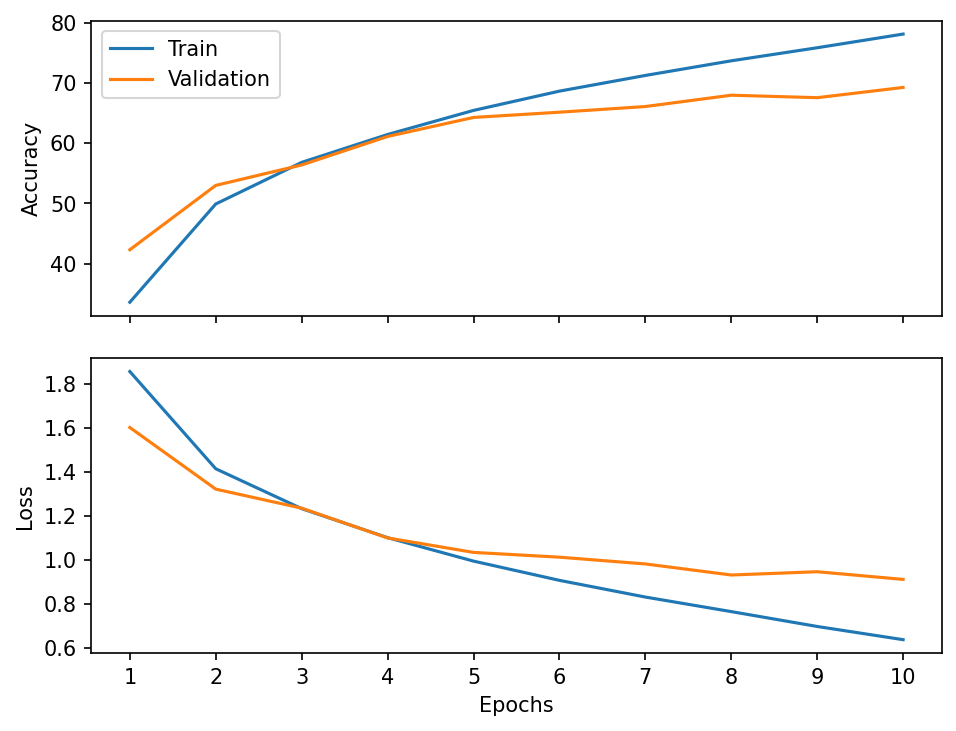

Test steps: 79 1.44s test_loss: 0.914790 test_acc: 69.880000                                
Exactitude en test: 69.88


In [18]:
model = CifarNet()
model.cuda()
optimizer = optim.SGD(model.parameters(), lr=lr, momentum=0.9, nesterov=True)
history_SGDMN = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history_SGDMN.display()
print('Exactitude en test: {:.2f}'.format(test(model, cifar_test, batch_size)))

 - Complétez cette cellule pour entraîner avec Adam

Epoch:  1/10 Train steps: 313 Val steps: 79 8.87s loss: 1.843059 acc: 34.010000 val_loss: 1.520393 val_acc: 46.880000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.20s loss: 1.455918 acc: 47.862500 val_loss: 1.438658 val_acc: 48.640000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.81s loss: 1.390259 acc: 50.515000 val_loss: 1.411159 val_acc: 49.920000
Epoch:  4/10 Train steps: 313 Val steps: 79 8.72s loss: 1.344093 acc: 52.245000 val_loss: 1.364362 val_acc: 51.790000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.38s loss: 1.313483 acc: 53.340000 val_loss: 1.387013 val_acc: 51.260000
Epoch:  6/10 Train steps: 313 Val steps: 79 8.59s loss: 1.304443 acc: 53.565000 val_loss: 1.366865 val_acc: 51.620000
Epoch:  7/10 Train steps: 313 Val steps: 79 8.81s loss: 1.286554 acc: 54.427500 val_loss: 1.338795 val_acc: 53.130000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.80s loss: 1.273649 acc: 54.835000 val_loss: 1.328463 val_acc: 53.330000
Epoch:  9/10 Train steps: 313 Val steps: 79 9.22s loss: 

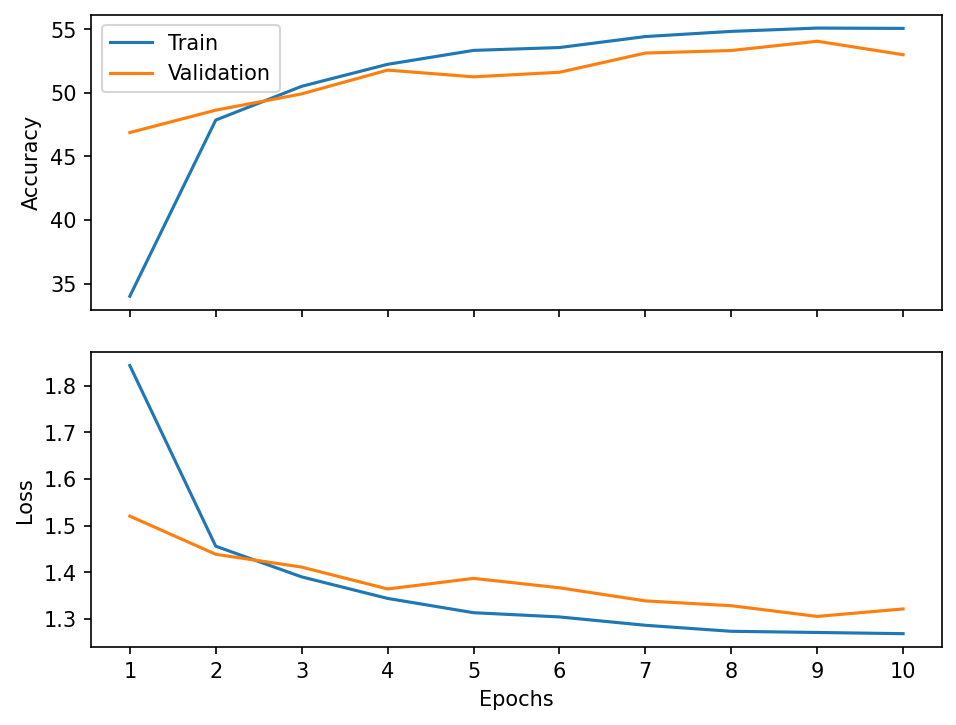

Test steps: 79 1.38s test_loss: 1.314575 test_acc: 53.020000                                
Exactitude en test: 53.02


In [19]:
model = CifarNet()
model.cuda()
optimizer = optim.Adam(model.parameters(), lr=lr)
history_adam = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history_adam.display()
print('Exactitude en test: {:.2f}'.format(test(model, cifar_test, batch_size)))

Epoch:  1/10 Train steps: 313 Val steps: 79 8.76s loss: 1.695108 acc: 38.735000 val_loss: 1.473319 val_acc: 46.730000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.85s loss: 1.342286 acc: 52.140000 val_loss: 1.242527 val_acc: 56.100000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.32s loss: 1.172890 acc: 58.970000 val_loss: 1.149995 val_acc: 59.640000
Epoch:  4/10 Train steps: 313 Val steps: 79 9.27s loss: 1.058877 acc: 63.040000 val_loss: 1.062153 val_acc: 62.960000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.93s loss: 0.965975 acc: 66.310000 val_loss: 1.014324 val_acc: 64.490000
Epoch:  6/10 Train steps: 313 Val steps: 79 8.97s loss: 0.903698 acc: 68.637500 val_loss: 0.961773 val_acc: 66.600000
Epoch:  7/10 Train steps: 313 Val steps: 79 8.26s loss: 0.846872 acc: 70.550000 val_loss: 0.953397 val_acc: 67.120000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.90s loss: 0.804779 acc: 72.117500 val_loss: 0.945102 val_acc: 66.810000
Epoch:  9/10 Train steps: 313 Val steps: 79 9.76s loss: 

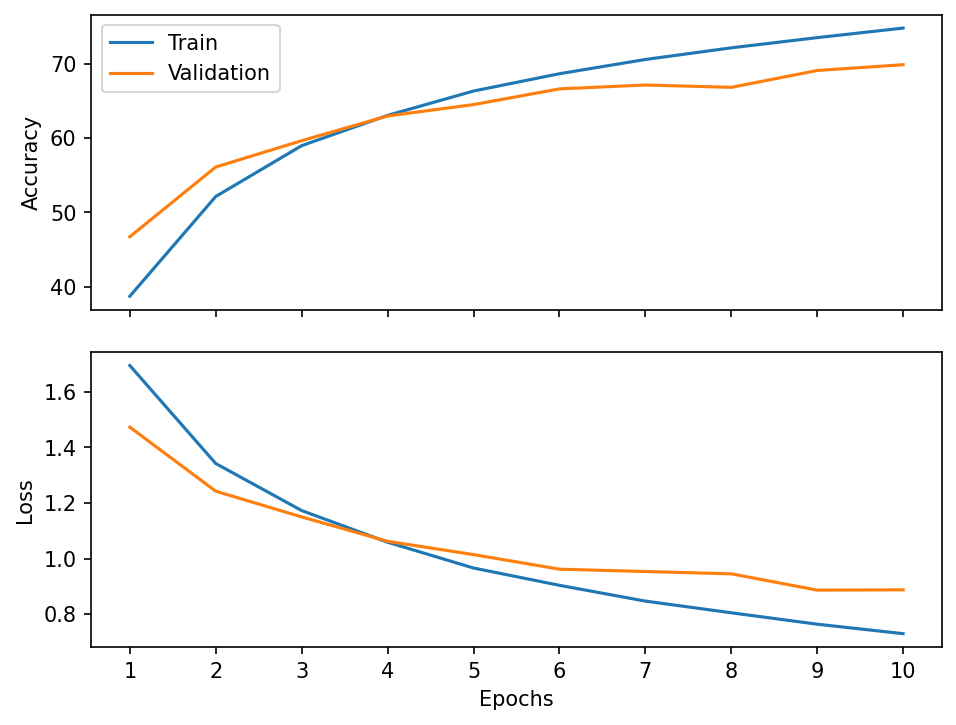

Test steps: 79 1.41s test_loss: 0.895431 test_acc: 69.800000                                
Exactitude en test: 69.80


In [20]:
model = CifarNet()
model.cuda()
optimizer = optim.Adam(model.parameters(), lr=0.001)
history_adam = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history_adam.display()
print('Exactitude en test: {:.2f}'.format(test(model, cifar_test, batch_size)))

#### Questions
- Quelle méthode semble être la meilleure dans ce cas-ci?
Dans ce cas précis, le SGD+momentum+nesterov semble la meilleure puisqu'elle obtient les meilleurs résultats en test.
- Remarquez-vous une différence d'overfitting?
Les performances en train vs validation du SGD+momentum+nesterov commence à se séparer vers la fin de l'entraînement, ce qui peut indiquer un début d'overfitting.
- Dans une nouvelle cellule, changez le taux d'apprentissage de Adam pour 0.001. Que remarquez-vous maintenant?
Adam est maintenant aussi performant que SGD+momentum+nesterov, le taux d'apprentissage était donc trop élevé pour l'optimiseur Adam.

Pour la réponse à la question 3:

Epoch:  1/10 Train steps: 313 Val steps: 79 8.85s loss: 1.637866 acc: 40.765000 val_loss: 1.405619 val_acc: 50.100000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.63s loss: 1.303323 acc: 53.465000 val_loss: 1.238598 val_acc: 56.610000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.44s loss: 1.125017 acc: 60.342500 val_loss: 1.098921 val_acc: 61.900000
Epoch:  4/10 Train steps: 313 Val steps: 79 8.84s loss: 1.001632 acc: 65.042500 val_loss: 1.042790 val_acc: 62.990000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.81s loss: 0.916861 acc: 68.162500 val_loss: 1.044402 val_acc: 63.550000
Epoch:  6/10 Train steps: 313 Val steps: 79 8.58s loss: 0.847101 acc: 70.847500 val_loss: 0.934991 val_acc: 67.420000
Epoch:  7/10 Train steps: 313 Val steps: 79 9.41s loss: 0.790747 acc: 72.532500 val_loss: 0.896849 val_acc: 68.930000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.87s loss: 0.727588 acc: 74.732500 val_loss: 0.873465 val_acc: 70.140000
Epoch:  9/10 Train steps: 313 Val steps: 79 8.77s loss: 

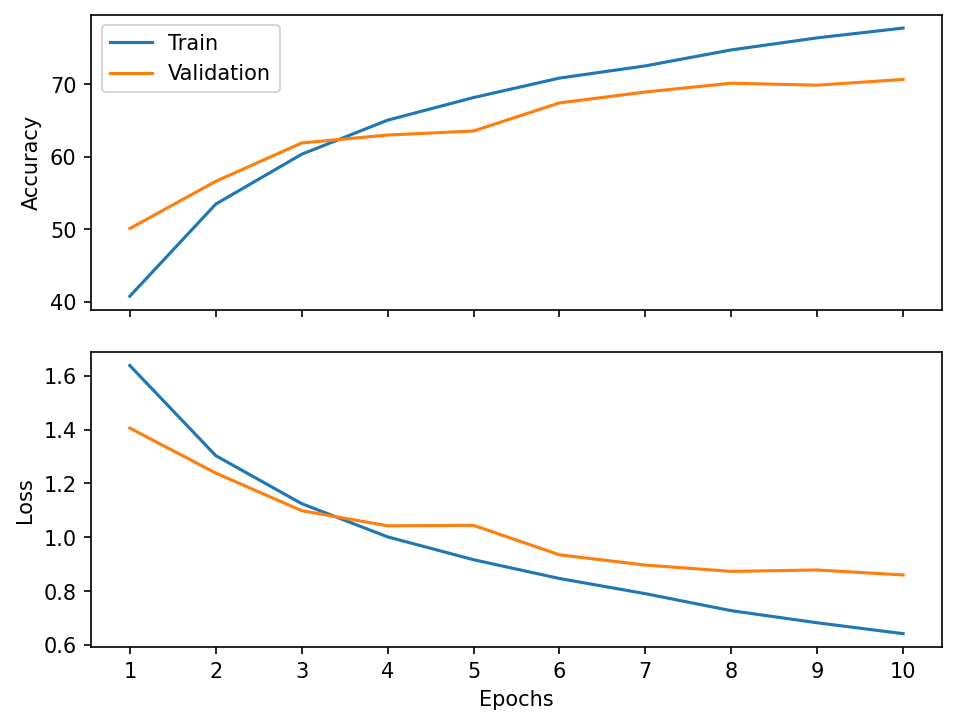

Test steps: 79 1.76s test_loss: 0.866016 test_acc: 71.300000                                
Exactitude en test: 71.30


In [21]:
model = CifarNet()
model.cuda()
optimizer = optim.Adam(model.parameters(), lr=0.001)
history_adam = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history_adam.display()
print('Exactitude en test: {:.2f}'.format(test(model, cifar_test, batch_size)))

## Partie 2: Horaire d'entraînement

Une pratique courante utilisée en apprentissage profond est de faire diminuer le taux d'apprentissage pendant l'entraînement.

Pour ce faire, PyTorch fournit plusieurs fonctions (ExponentialLR, LambdaLR, MultiStepLR, etc.).  Dans ce notebook, on utilisera les [callbacks correspondant de Poutyne](https://poutyne.org/callbacks.html#lr-schedulers) qui cachent sous le capot les fonctions de PyTorch.

Voici un exemple avec ExponentialLR.

In [22]:
model = CifarNet()
model.cuda()

batch_size = 128
lr = 0.01
n_epoch = 10

optimizer = optim.SGD(model.parameters(), lr=lr)

gamma = 0.8
scheduler = pt.ExponentialLR(gamma)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, callbacks=[scheduler], use_gpu=True)

Epoch:  1/10 Train steps: 313 Val steps: 79 8.44s loss: 2.280856 acc: 15.040000 val_loss: 2.235281 val_acc: 22.650000
Epoch:  2/10 Train steps: 313 Val steps: 79 8.31s loss: 2.133176 acc: 24.215000 val_loss: 2.024217 val_acc: 26.980000
Epoch:  3/10 Train steps: 313 Val steps: 79 8.69s loss: 1.968042 acc: 30.415000 val_loss: 1.928931 val_acc: 31.110000
Epoch:  4/10 Train steps: 313 Val steps: 79 8.74s loss: 1.882814 acc: 33.960000 val_loss: 1.838521 val_acc: 36.420000
Epoch:  5/10 Train steps: 313 Val steps: 79 8.11s loss: 1.810908 acc: 36.747500 val_loss: 1.775804 val_acc: 37.680000
Epoch:  6/10 Train steps: 313 Val steps: 79 8.61s loss: 1.750070 acc: 39.035000 val_loss: 1.726333 val_acc: 40.040000
Epoch:  7/10 Train steps: 313 Val steps: 79 8.68s loss: 1.704640 acc: 40.525000 val_loss: 1.687939 val_acc: 41.240000
Epoch:  8/10 Train steps: 313 Val steps: 79 8.27s loss: 1.668397 acc: 41.545000 val_loss: 1.664975 val_acc: 41.560000
Epoch:  9/10 Train steps: 313 Val steps: 79 8.44s loss: 

Affichons la valeur du taux d'apprentissage.

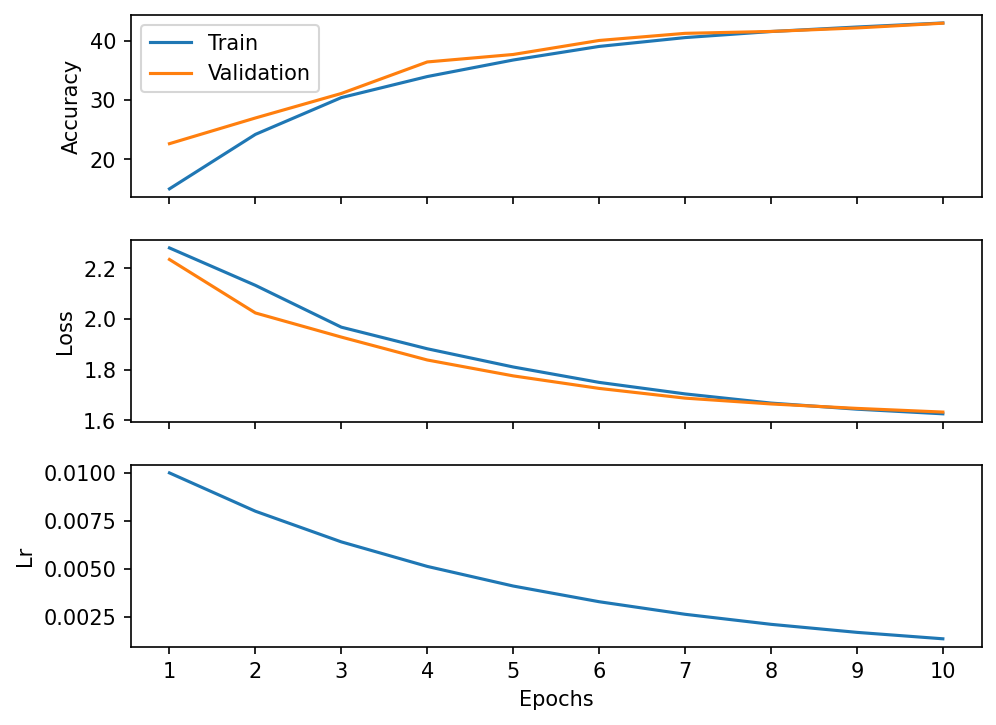

In [23]:
history.display(display_lr=True)

#### Exercice

- Utilisez [MultiStepLR](http://pytorch.org/docs/master/optim.html#torch.optim.lr_scheduler.MultiStepLR) pour modifier le taux d'apprentissage pour un epoch précis.

1. Commencez avec un taux d'apprentissage trop élevé pour que le réseau puisse apprendre quelque chose.
2. Diminuez-le progressivement jusqu'à ce que le réseau apprenne.
3. Trouvez le moment où la validation semble avoir atteint un plateau.
4. Diminuez le taux par 2 à ce moment et réentraîner le réseau.

In [9]:
torch.manual_seed(42)
model = CifarNet()
model.cuda()

epoch_list = [7, 10] # TODO liste à remplir au fur et à mesure que les points 3 et 4 sont itérés.

batch_size = 128
lr = 0.1
n_epoch = 20

optimizer = optim.SGD(model.parameters(), lr=lr)
scheduler = pt.MultiStepLR(milestones=epoch_list, gamma=0.5)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, callbacks=[scheduler], use_gpu=True)

Epoch:  1/20 Train steps: 313 Val steps: 79 8.90s loss: 2.076154 acc: 25.032500 val_loss: 1.864599 val_acc: 36.290000
Epoch:  2/20 Train steps: 313 Val steps: 79 8.53s loss: 1.610306 acc: 43.142500 val_loss: 1.561746 val_acc: 43.990000
Epoch:  3/20 Train steps: 313 Val steps: 79 8.64s loss: 1.390658 acc: 50.852500 val_loss: 1.373097 val_acc: 51.360000
Epoch:  4/20 Train steps: 313 Val steps: 79 8.88s loss: 1.260230 acc: 55.695000 val_loss: 1.245018 val_acc: 56.320000
Epoch:  5/20 Train steps: 313 Val steps: 79 8.74s loss: 1.144753 acc: 59.892500 val_loss: 1.174657 val_acc: 59.120000
Epoch:  6/20 Train steps: 313 Val steps: 79 8.20s loss: 1.041242 acc: 63.847500 val_loss: 1.103063 val_acc: 61.600000
Epoch:  7/20 Train steps: 313 Val steps: 79 8.74s loss: 0.954798 acc: 66.765000 val_loss: 1.020402 val_acc: 64.350000
Epoch:  8/20 Train steps: 313 Val steps: 79 8.77s loss: 0.799146 acc: 72.607500 val_loss: 1.043158 val_acc: 64.070000
Epoch:  9/20 Train steps: 313 Val steps: 79 8.46s loss: 

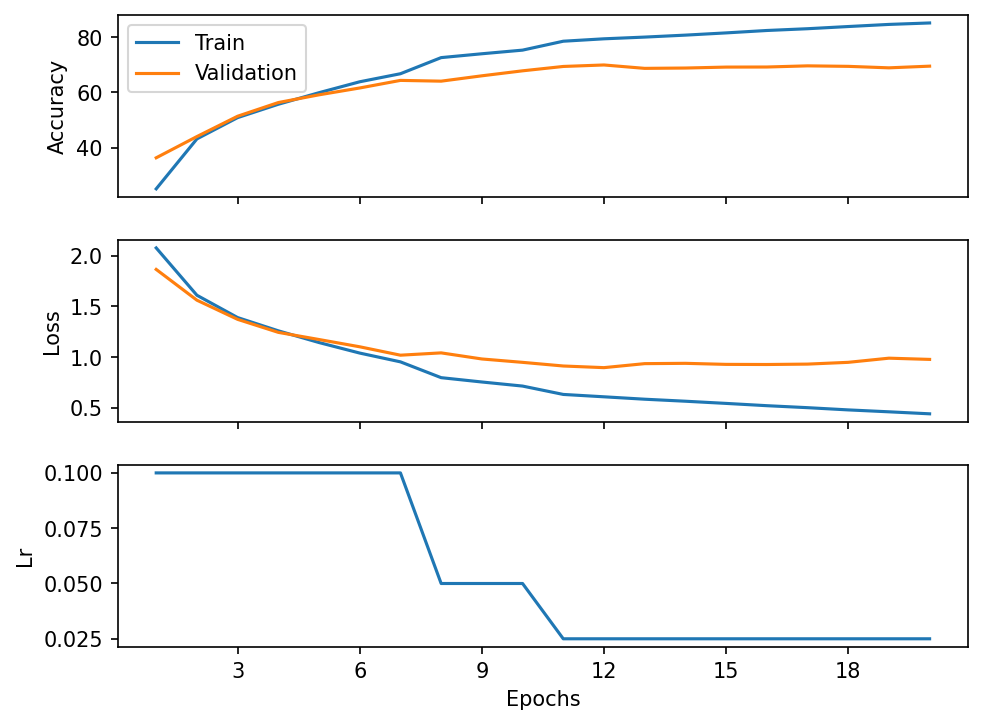

In [10]:
history.display(display_lr=True)

#### Questions
- Voyez-vous une différence en diminuant le taux d'apprentissage par 2 après x epochs?
Oui, on converge vers une meilleure performance lorsqu'on diminue le taux d'apprentissage.
- Pourquoi?
Car on diminue les corrections apportées par le gradient et l'on se rapproche donc plus d'un minimum local pour l'optimisation plutôt que d'alterner d'un bord et de l'autre du minimum.

### Pour aller plus loin sur les horaires d'entraînement

On vient de faire "à la main" ce que la classe [ReduceLROnPlateau](https://pytorch.org/docs/stable/optim.html#torch.optim.lr_scheduler.ReduceLROnPlateau) de PyTorch nous permet de faire automatiquement. Essentiellement, cette classe nous permet de monitorer une métrique et de réduire le taux d'apprentissage lorsque cette métrique stagne pour un certain nombre d'epochs. Ce nombre d'epoch est appelé la "patience". Nous allons utiliser le callback [poutyne.ReduceLROnPlateau](https://poutyne.org/callbacks.html#poutyne.ReduceLROnPlateau) de Poutyne qui prend en paramètre le nom de la métrique à monitorer en plus des autres arguments de la classe de PyTorch.

Notez bien la description du paramètre `patience` dans la documentation de PyTorch:
> **patience** - Number of epochs with no improvement after which learning rate will be reduced. For example, if patience = 2, then we will ignore the first 2 epochs with no improvement, and will only decrease the LR after the 3rd epoch if the loss still hasn’t improved then.

Dans la cellule ci-dessous, on monitore l'exactitude en validation avec une patience de 1 epoch.

In [11]:
torch.manual_seed(42)
model = CifarNet()
model.cuda()

batch_size = 128
lr = 0.5
n_epoch = 20

optimizer = optim.SGD(model.parameters(), lr=lr)
scheduler = pt.ReduceLROnPlateau(monitor='val_acc', mode='max', patience=1, factor=0.5)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, callbacks=[scheduler], use_gpu=True)

Epoch:  1/20 Train steps: 313 Val steps: 79 9.38s loss: 2.123753 acc: 22.055000 val_loss: 1.869942 val_acc: 32.070000
Epoch:  2/20 Train steps: 313 Val steps: 79 8.71s loss: 1.792850 acc: 36.042500 val_loss: 1.729397 val_acc: 38.370000
Epoch:  3/20 Train steps: 313 Val steps: 79 8.38s loss: 1.563953 acc: 44.502500 val_loss: 1.498937 val_acc: 45.730000
Epoch:  4/20 Train steps: 313 Val steps: 79 8.50s loss: 1.377525 acc: 51.270000 val_loss: 1.355591 val_acc: 53.140000
Epoch:  5/20 Train steps: 313 Val steps: 79 8.77s loss: 1.274929 acc: 55.092500 val_loss: 1.356576 val_acc: 53.170000
Epoch:  6/20 Train steps: 313 Val steps: 79 8.82s loss: 1.179190 acc: 58.652500 val_loss: 1.340949 val_acc: 54.540000
Epoch:  7/20 Train steps: 313 Val steps: 79 8.15s loss: 1.118116 acc: 61.150000 val_loss: 1.411711 val_acc: 51.580000
Epoch:  8/20 Train steps: 313 Val steps: 79 8.73s loss: 1.045711 acc: 63.652500 val_loss: 1.384804 val_acc: 55.900000
Epoch:  9/20 Train steps: 313 Val steps: 79 10.81s loss:

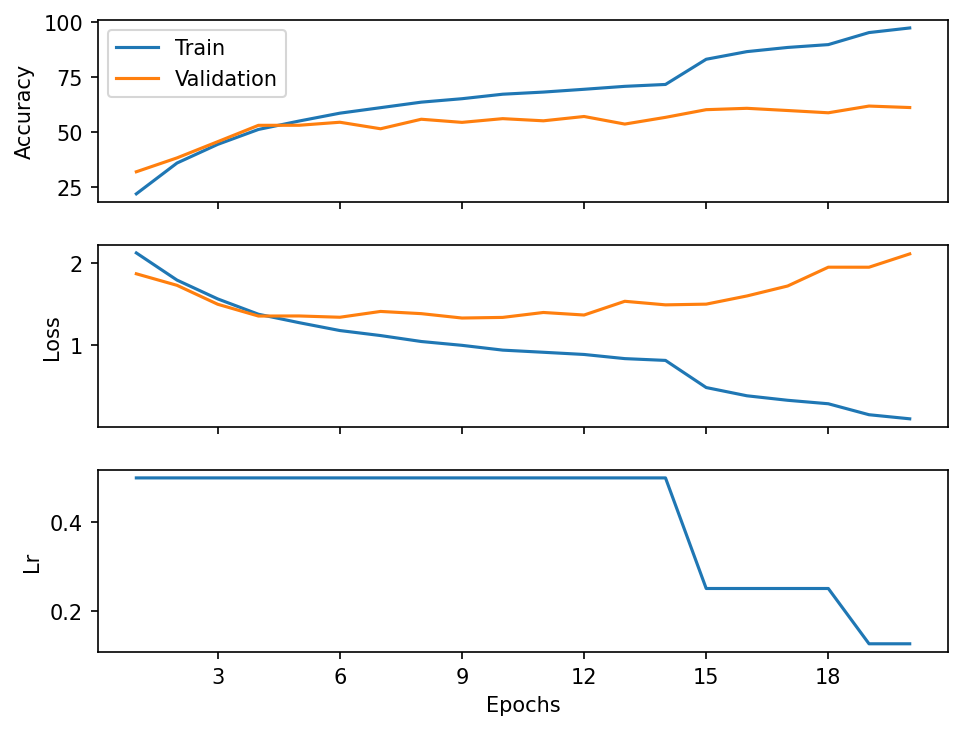

In [12]:
history.display(display_lr=True)

## Partie 3: Batch Normalization

Voici l'architecture du réseau de neurones convolutionnels que vous avez utilisé jusqu'à présent pour faire de la classification sur Cifar10.

In [18]:
import torch.nn.functional as F

class CifarNetBatchNorm(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 10, 3, padding=1)
        self.conv2 = nn.Conv2d(10, 50, 3, padding=1)
        self.conv3 = nn.Conv2d(50, 150, 3, padding=1)
        self.batchnorm1 = nn.BatchNorm2d(10)
        self.batchnorm2 = nn.BatchNorm2d(50)
        self.batchnorm3 = nn.BatchNorm2d(150)
        self.fc1 = nn.Linear(150 * 8 * 8, 10)

    def forward(self, x):
        x = F.max_pool2d(F.relu(self.batchnorm1(self.conv1(x))), (2, 2))
        x = F.max_pool2d(F.relu(self.batchnorm2(self.conv2(x))), 2)
        x = F.relu(self.batchnorm3(self.conv3(x)))
        x = x.flatten(1)
        x = self.fc1(x)
        return x

#### Exercice

- Modifier l'architecture du réseau en ajoutant de la batch normalization entre les couches de convolutions et les ReLUs (essentiellement, on devait avoir `Conv2d -> BatchNorm2d -> ReLU`) et entraîner le nouveau réseau.

Epoch: 1/5 Train steps: 313 Val steps: 79 9.19s loss: 1.584482 acc: 44.842500 val_loss: 1.377979 val_acc: 50.380000
Epoch: 2/5 Train steps: 313 Val steps: 79 8.36s loss: 1.173765 acc: 58.790000 val_loss: 1.678480 val_acc: 48.760000
Epoch: 3/5 Train steps: 313 Val steps: 79 8.91s loss: 1.007752 acc: 64.987500 val_loss: 1.413763 val_acc: 51.940000
Epoch: 4/5 Train steps: 313 Val steps: 79 8.96s loss: 0.916957 acc: 68.365000 val_loss: 1.211684 val_acc: 57.170000
Epoch: 5/5 Train steps: 313 Val steps: 79 9.02s loss: 0.839497 acc: 70.987500 val_loss: 1.140894 val_acc: 60.120000


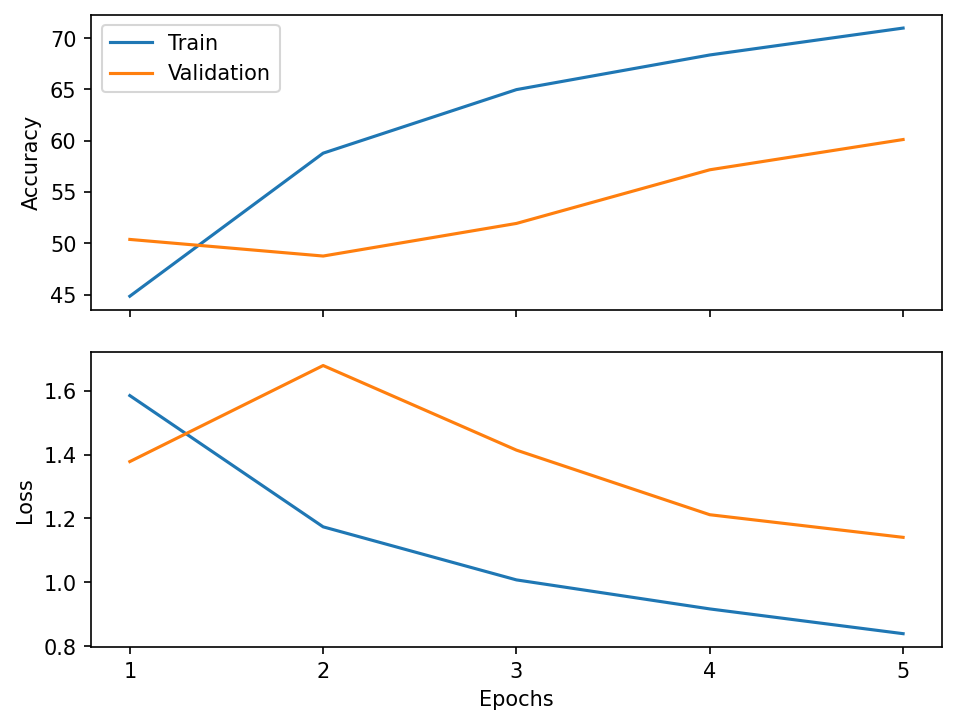

In [19]:
model = CifarNetBatchNorm()
model.cuda()

lr = 0.01
batch_size = 128
n_epoch = 5

optimizer = optim.SGD(model.parameters(), lr=lr)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)
history.display()

#### Questions

- Comparer l'entraînement du réseau avec et sans la batch normalization (Section 1.2 avec SGD, où on a entraîné le réseau sans batch normalization avec le même taux d'apprentissage). Que remarquez-vous? L'apprentissage atteint de meilleures performances avec le batch_norm que sans le batch_norm.

### Effet de la batch normalization sur le taux d'apprentissage

Commençons par entraîner un réseau avec un taux d'apprentissage élevé. Vous pouvez augmenter le nombre d'epochs si vous voulez voir une plus grande différence.

In [20]:
lr = 0.5
batch_size = 1024
n_epoch = 10

In [21]:
model = CifarNet()
model.cuda()
optimizer = optim.SGD(model.parameters(), lr=lr)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)

Epoch:  1/10 Train steps: 40 Val steps: 10 7.75s loss: 2.297440 acc: 12.200000 val_loss: 2.294506 val_acc: 10.150000
Epoch:  2/10 Train steps: 40 Val steps: 10 8.24s loss: 2.311697 acc: 10.862500 val_loss: 2.302547 val_acc: 10.110000
Epoch:  3/10 Train steps: 40 Val steps: 10 8.28s loss: 2.397132 acc: 12.762500 val_loss: 2.307668 val_acc: 10.110000
Epoch:  4/10 Train steps: 40 Val steps: 10 7.84s loss: 2.302823 acc: 10.020000 val_loss: 2.305024 val_acc: 10.220000
Epoch:  5/10 Train steps: 40 Val steps: 10 8.15s loss: 2.301898 acc: 10.942500 val_loss: 2.304072 val_acc: 10.330000
Epoch:  6/10 Train steps: 40 Val steps: 10 8.26s loss: 2.303224 acc: 10.320000 val_loss: 2.303926 val_acc: 9.430000
Epoch:  7/10 Train steps: 40 Val steps: 10 7.74s loss: 2.302927 acc: 9.750000 val_loss: 2.302865 val_acc: 9.930000
Epoch:  8/10 Train steps: 40 Val steps: 10 8.10s loss: 2.302889 acc: 9.950000 val_loss: 2.305230 val_acc: 9.890000
Epoch:  9/10 Train steps: 40 Val steps: 10 8.37s loss: 2.303061 acc: 

Essayons maintenant d'entraîner le réseau utilisant la batch normalization avec les mêmes hyperparamètres.

In [22]:
model = CifarNetBatchNorm()
model.cuda()
optimizer = optim.SGD(model.parameters(), lr=lr)

history = train(model, optimizer, cifar_train, n_epoch, batch_size, use_gpu=True)

Epoch:  1/10 Train steps: 40 Val steps: 10 9.30s loss: 5.237391 acc: 16.242500 val_loss: 2.311881 val_acc: 16.120000
Epoch:  2/10 Train steps: 40 Val steps: 10 8.15s loss: 1.940931 acc: 30.037500 val_loss: 1.954695 val_acc: 28.570000
Epoch:  3/10 Train steps: 40 Val steps: 10 8.78s loss: 1.785481 acc: 35.390000 val_loss: 2.527553 val_acc: 25.670000
Epoch:  4/10 Train steps: 40 Val steps: 10 8.47s loss: 1.687583 acc: 39.507500 val_loss: 2.183607 val_acc: 28.500000
Epoch:  5/10 Train steps: 40 Val steps: 10 8.44s loss: 1.601263 acc: 42.270000 val_loss: 1.773637 val_acc: 37.890000
Epoch:  6/10 Train steps: 40 Val steps: 10 7.78s loss: 1.522278 acc: 44.840000 val_loss: 1.895585 val_acc: 34.480000
Epoch:  7/10 Train steps: 40 Val steps: 10 8.39s loss: 1.474115 acc: 46.727500 val_loss: 1.857242 val_acc: 35.770000
Epoch:  8/10 Train steps: 40 Val steps: 10 8.43s loss: 1.430499 acc: 48.225000 val_loss: 3.354797 val_acc: 16.440000
Epoch:  9/10 Train steps: 40 Val steps: 10 7.80s loss: 1.416376 

#### Questions
- Que pouvez-vous conclure sur l'effet de la batch normalization sur le taux d'apprentissage? La batch_norm permet d'avoir un taux d'apprentissage plus élevé et de tout de même apprendre. Le réseau sans batch_norm n'a rien appris alors que le réseau avec batch_norm a atteint des performances de 37%

### Analyse

Après l'entraînement, il est important d'analyser les résultats obtenus.
Commençons par tester le réseau en utilisant la fonction `validate_ranking`.
Cette fonction sépare les résultats bien classés des erreurs et retourne pour chaque image, un score (qu'on peut voir comme une probabilité), la vraie classe et la classe prédite.

In [23]:
good, errors = validate_ranking(model, cifar_test, batch_size, use_gpu=True)

Maintenant, regardons quelques exemples d'images bien classés.

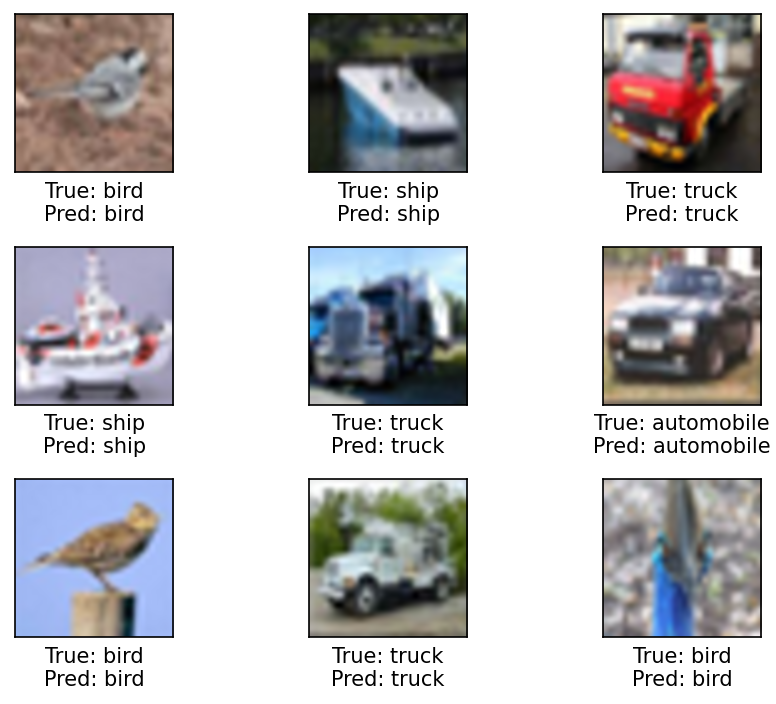

In [24]:
show_random(good)

Et quelques exemples mal classés.

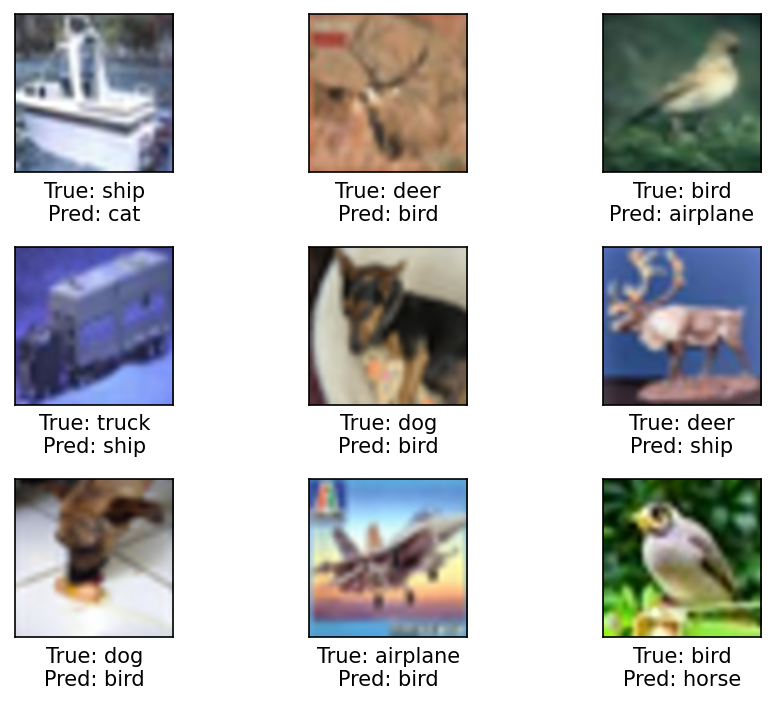

In [25]:
show_random(errors)

Il est aussi possible de regarder les exemples où le réseau est le plus confiant.

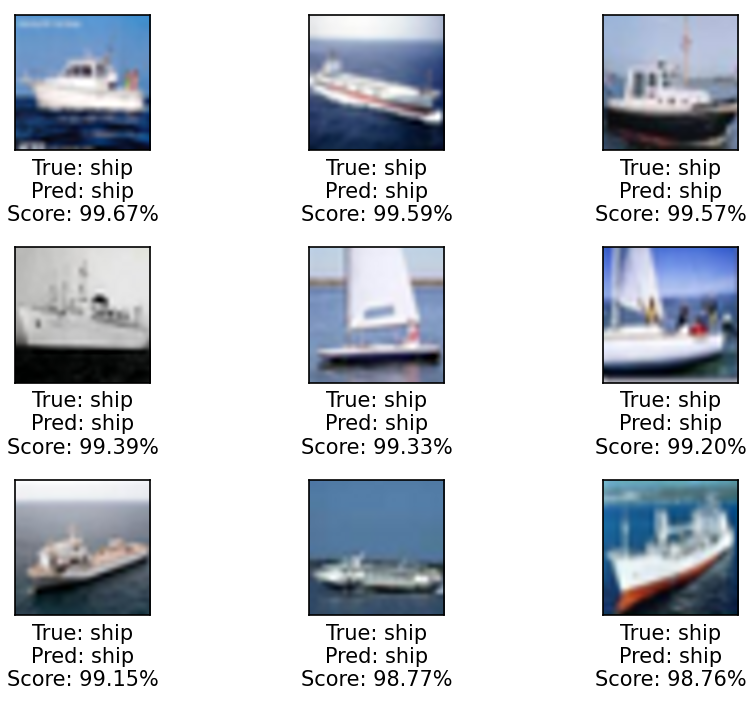

In [26]:
show_best(good)

Ou l'inverse, ceux qui ont obtenus les moins bons scores.

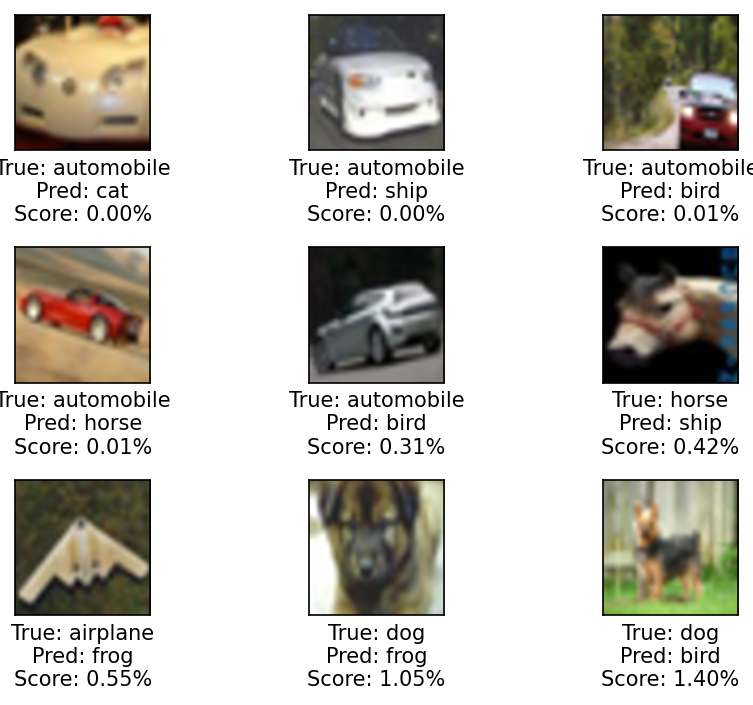

In [27]:
show_worst(errors)

Finalement, il peut être intéressant de regarder les exemples les plus difficiles.
Soit ceux qui ont été bien classés, mais qui ont eu un mauvais score.

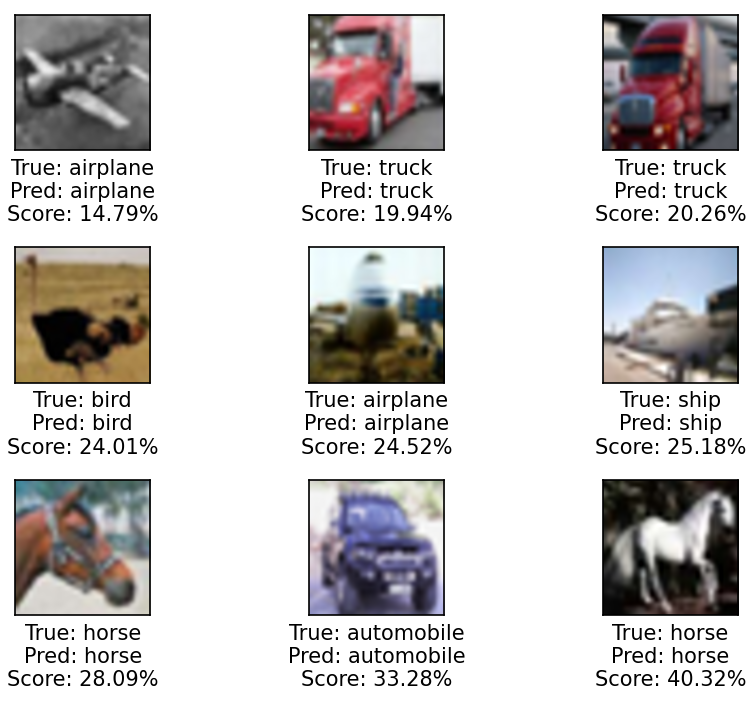

In [28]:
show_worst(good)

Ou ceux qui ont été mal classés, mais qui ont quand même réussi à obtenir un bon score.

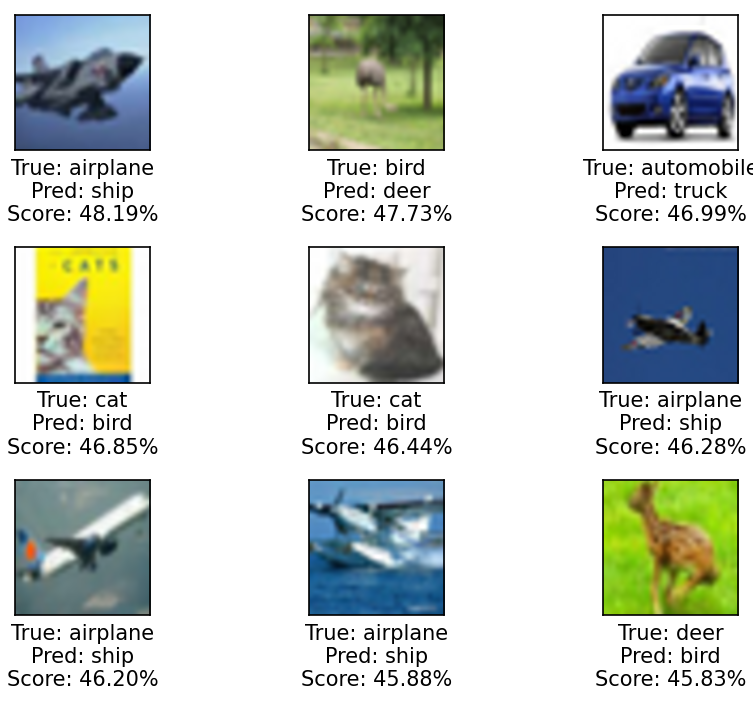

In [29]:
show_best(errors)

#### Questions
- En observant les résultats obtenus, que pouvez-vous dire sur les performances du réseau? Les performances ne sont pas excellentes, le réseau effectue beaucoup d'erreurs mais s'en sort malgré tout avec certaines classes.
- Quelle classe semble être facile? Pourquoi? La classe la plus facile semble être ship, puisque le réseau cherche une forme sur fond bleu.
- Quelle classe semble être difficile? Pourquoi? La plus difficile semble être automobile puisque les images varient beaucoup de point de vue et sont donc plus difficiles à classifier.

## Partie 4: Initialisation des poids

Dans cette section, vous testerez différentes techniques d'initialisations et observerez leurs effets sur le gradient et l'entraînement.

In [30]:
cifar_train, cifar_test = load_cifar10()
cifar_train.transform = ToTensor()
cifar_test.transform = ToTensor()

train_loader, valid_loader = train_valid_loaders(cifar_train, 10)

On crée ici un réseau de neurones assez simple composé de 5 couches cachées (6 couches au total) et avec un choix pour la fonction d'activation.

In [31]:
activations = dict(
    tanh=nn.Tanh,
    relu=nn.ReLU
)

def create_fully_connected_network(activation):
    assert activation in activations
    activation = activations[activation]
    num_neurons = 1000
    return nn.Sequential(
        nn.Flatten(),
        nn.Linear(32*32*3, num_neurons),
        activation(),
        nn.Linear(num_neurons, num_neurons),
        activation(),
        nn.Linear(num_neurons, num_neurons),
        activation(),
        nn.Linear(num_neurons, num_neurons),
        activation(),
        nn.Linear(num_neurons, num_neurons),
        activation(),
        nn.Linear(num_neurons, 10)
    )

On va jouer avec différentes fonctions d'initialisation. Créons donc une fonction nous permettant d'initialiser tous les poids de notre réseau de neurones.

In [32]:
def initialize_network(network, initialization_function):
    for module in network.modules():
        if isinstance(module, nn.Linear):
            initialization_function(module.weight)
            init.zeros_(module.bias)

On s'intéresse aux gradients qui circulent dans le réseau de neurones lors de la rétropropagation de manière générale.
Ceci est à distinguer du gradient calculé pour chacun des poids individuels du réseau de neurones.
Le gradient circulant pendant la rétropropagation nous donne une idée de la possibilité de changements des poids de la couche en question.
Étant donné que le gradient est le même lors de l'addition, on peut se servir du biais pour mesurer le gradient circulant dans le réseau.
Les fonctions suivantes procèdent donc de la façon suivante:
- On parcourt le jeu de données d'entraînement en batch;
- Pour chacune des batchs, on garde pour chacune des couches le gradient des biais de la couche;
- Une fois que toutes les batchs ont été traitées, on calcule un histogramme des gradients pour chaque couche.

In [33]:
def save_gradient(sequential_network, output_dictionary):
    layer_number = 1
    for layer in sequential_network:
        if isinstance(layer, nn.Linear):
            # On ignore la dernière couche qui est la couche de
            # classification.
            if layer_number == 6:
                continue

            with torch.no_grad():
                grad = layer.bias.grad.flatten().cpu().numpy()
            grad = grad[grad != 0]
            output_dictionary[layer_number].append(grad)
            layer_number += 1

def plot_gradients_per_layer(gradients_per_layer):
    for layer_number, grads in gradients_per_layer.items():
        grad = np.concatenate(grads)
        hist, bin_edges = np.histogram(grad, bins=100)
        hist = hist / hist.sum() * 100

        plt.plot(bin_edges[:-1], hist, label=f'Layer {layer_number}')

def plot_gradient(network):
    gradients_per_layer = defaultdict(list)
    network.cuda()
    for x, y in train_loader:
        x = x.cuda()
        y = y.cuda()

        output = network(x)
        loss = F.cross_entropy(output, y)
        loss.backward()

        save_gradient(network, gradients_per_layer)

        network.zero_grad(True)

    plot_gradients_per_layer(gradients_per_layer)
    plt.title('Gradient histogram')
    plt.xlabel('Gradient value')
    plt.ylabel('Count')
    plt.legend()

La fonction ci-dessous est la fonction qui est utilisée comme référence dans [l'article introduisant l'initialisation Glorot/Xavier](http://proceedings.mlr.press/v9/glorot10a/glorot10a.pdf) et est d'ailleurs celle utilisé par PyTorch par défaut dans les couches linéaires. Nous allons l'utiliser pour la comparer avec l'initialisation de Glorot/Xavier et celle de Kaiming He.

In [34]:
def standard_uniform(weight):
    bound = 1. / np.sqrt(weight.shape[1])
    init.uniform_(weight, -bound, bound)

### 4.1 Réseau avec activation tanh

La fonction tanh était la fonction d'activation la plus utilisée avant l'arrivée de la fonction ReLU. Plusieurs fonctions d'initialisation ont donc été conçues avec cette fonction d'activation en tête. Investiguons donc l'effet des différentes fonctions d'initialisation sur un réseau avec des activations tanh.

In [35]:
tanh_network = create_fully_connected_network('tanh')
tanh_network

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=3072, out_features=1000, bias=True)
  (2): Tanh()
  (3): Linear(in_features=1000, out_features=1000, bias=True)
  (4): Tanh()
  (5): Linear(in_features=1000, out_features=1000, bias=True)
  (6): Tanh()
  (7): Linear(in_features=1000, out_features=1000, bias=True)
  (8): Tanh()
  (9): Linear(in_features=1000, out_features=1000, bias=True)
  (10): Tanh()
  (11): Linear(in_features=1000, out_features=10, bias=True)
)

Regardons l'histogramme des gradients lorsqu'on utilise l'initialisation standard (de référence).

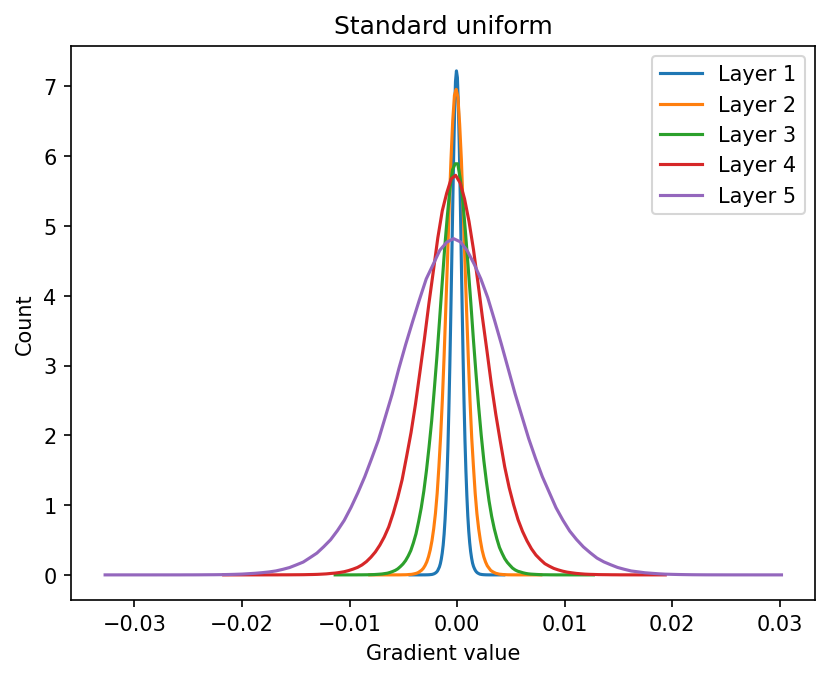

In [36]:
initialize_network(tanh_network, standard_uniform)

plot_gradient(tanh_network)
plt.title('Standard uniform')
plt.show()

Regardons l'histogramme des gradients lorsqu'on utilise l'initialisation de Glorot/Xavier.

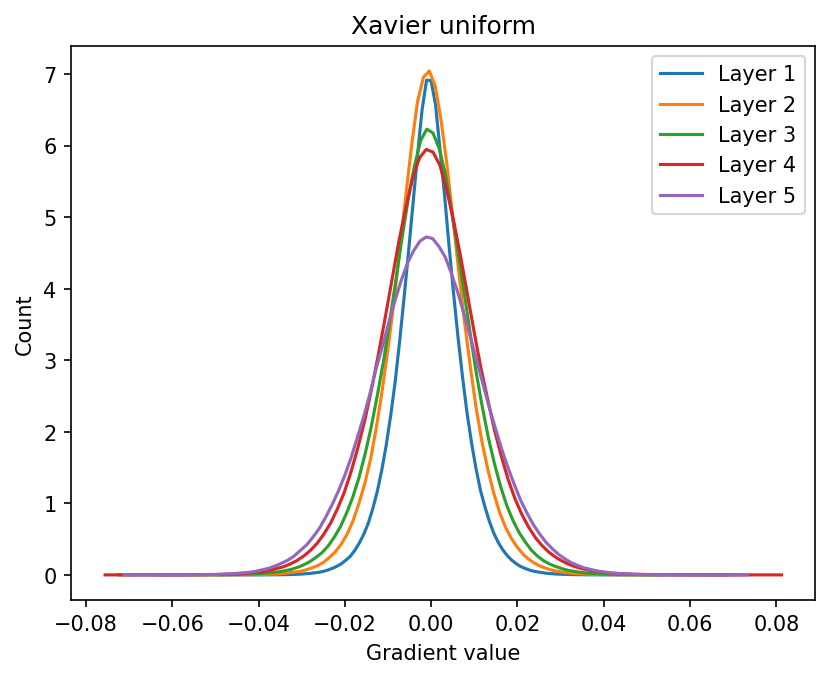

In [37]:
initialize_network(tanh_network, init.xavier_uniform_)

plot_gradient(tanh_network)
plt.title('Xavier uniform')
plt.show()

Regardons l'histogramme des gradients lorsqu'on utilise l'initialisation de Kaiming He.

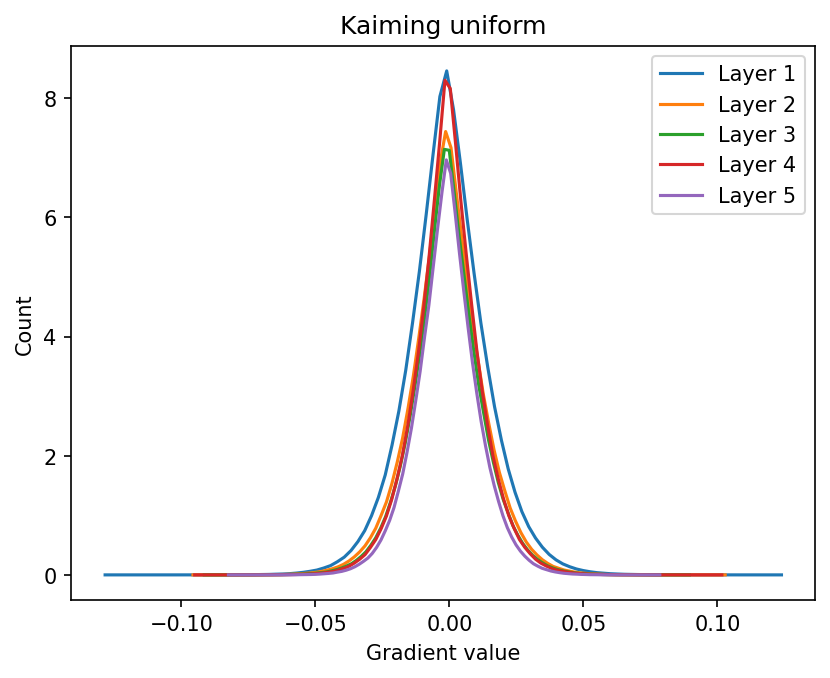

In [38]:
initialize_network(tanh_network, init.kaiming_uniform_)

plot_gradient(tanh_network)
plt.title('Kaiming uniform')
plt.show()

#### Questions
- À partir des graphiques pour chacune des fonctions d'initialisation, que peut-on dire sur la différence d'initialisation entre les différents types d'initialisation? La variance des gradients est différente, par contre toutes les initialisations ont une moyenne centrée à 0 pour le gradient.
- Intuitivement, pourquoi serait-il préférable d'avoir une variance similaire pour le gradient circulant dans chacune des couches? Une variance similaire veut dire que nous aurons une meilleure propagation du gradient entre les couches et ainsi moins de problèmes de vanishing gradient?

Maintenant que l'on a observé l'effet de l'initialisation sur le gradient circulant dans le réseau, regardons si l'effet est répercuté sur l'apprentissage.

In [39]:
batch_size = 128
epochs = 5

Entraînons le réseau avec l'initialisation standard.

Epoch: 1/5 Train steps: 313 Val steps: 79 7.45s loss: 2.284235 acc: 13.215000 val_loss: 2.255121 val_acc: 21.270000
Epoch: 2/5 Train steps: 313 Val steps: 79 7.93s loss: 2.163367 acc: 23.487500 val_loss: 2.082036 val_acc: 26.410000
Epoch: 3/5 Train steps: 313 Val steps: 79 7.91s loss: 2.037995 acc: 26.525000 val_loss: 2.010375 val_acc: 27.310000
Epoch: 4/5 Train steps: 313 Val steps: 79 7.50s loss: 1.967780 acc: 28.585000 val_loss: 1.954789 val_acc: 29.040000
Epoch: 5/5 Train steps: 313 Val steps: 79 8.32s loss: 1.918690 acc: 30.755000 val_loss: 1.902919 val_acc: 31.940000


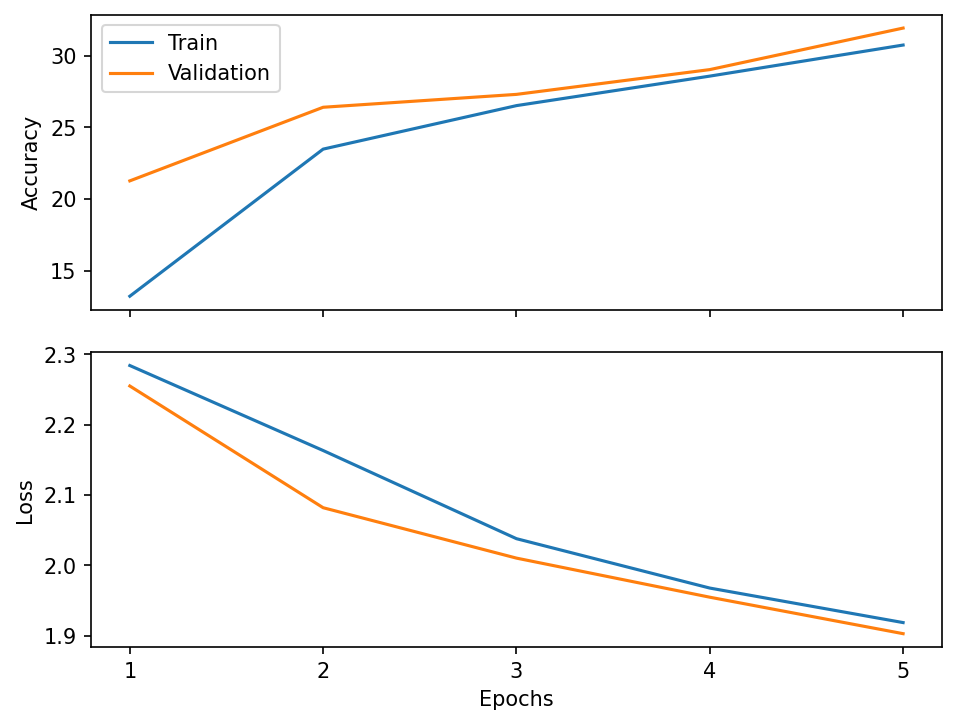

Test steps: 79 1.30s test_loss: 1.899506 test_acc: 31.580000                                
Exactitude en test: 31.58


In [40]:
initialize_network(tanh_network, standard_uniform)

history = train(tanh_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(tanh_network, cifar_test, batch_size)))

Regardons maintenant l'histogramme des gradients du réseau entraîné avec l'initialisation standard.

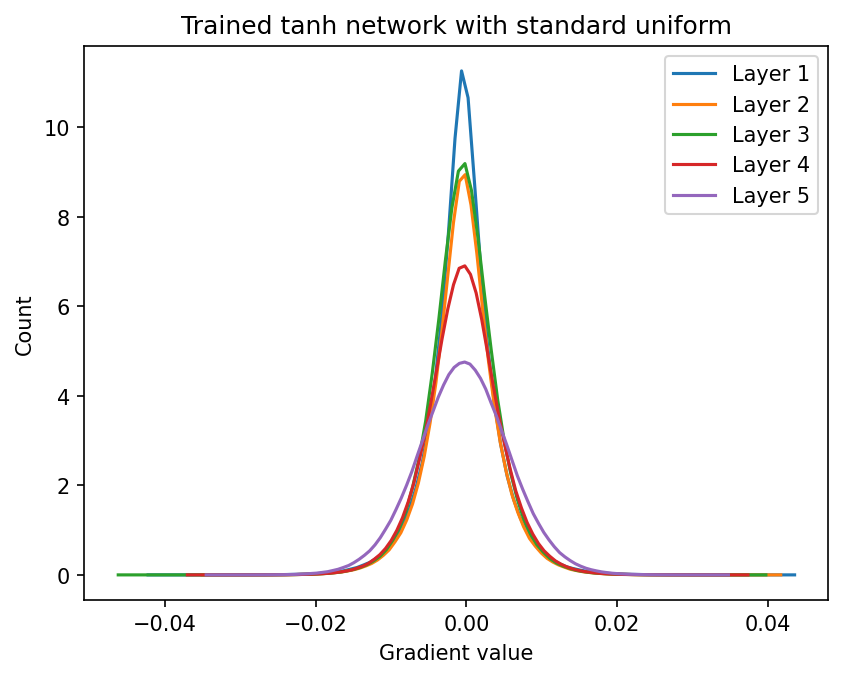

In [41]:
plot_gradient(tanh_network)
plt.title('Trained tanh network with standard uniform')
plt.show()

#### Questions
- Quelle différence remarquez-vous par rapport à l'histogramme du gradient circulant de l'initialisation standard avant l'entraînement (Voir le graphique "Standard uniform" plus haut) ? La variance des distributions est venu s'égaliser alors qu'elle ne l'était pas au départ.

Entraînons le réseau avec l'initialisation Xavier.

Epoch: 1/5 Train steps: 313 Val steps: 79 7.44s loss: 1.939181 acc: 30.835000 val_loss: 1.823421 val_acc: 35.680000
Epoch: 2/5 Train steps: 313 Val steps: 79 8.04s loss: 1.794988 acc: 36.722500 val_loss: 1.878311 val_acc: 33.810000
Epoch: 3/5 Train steps: 313 Val steps: 79 8.13s loss: 1.749703 acc: 38.297500 val_loss: 1.730277 val_acc: 39.080000
Epoch: 4/5 Train steps: 313 Val steps: 79 7.36s loss: 1.716157 acc: 39.670000 val_loss: 1.697656 val_acc: 39.700000
Epoch: 5/5 Train steps: 313 Val steps: 79 7.98s loss: 1.677221 acc: 40.950000 val_loss: 1.719523 val_acc: 38.580000


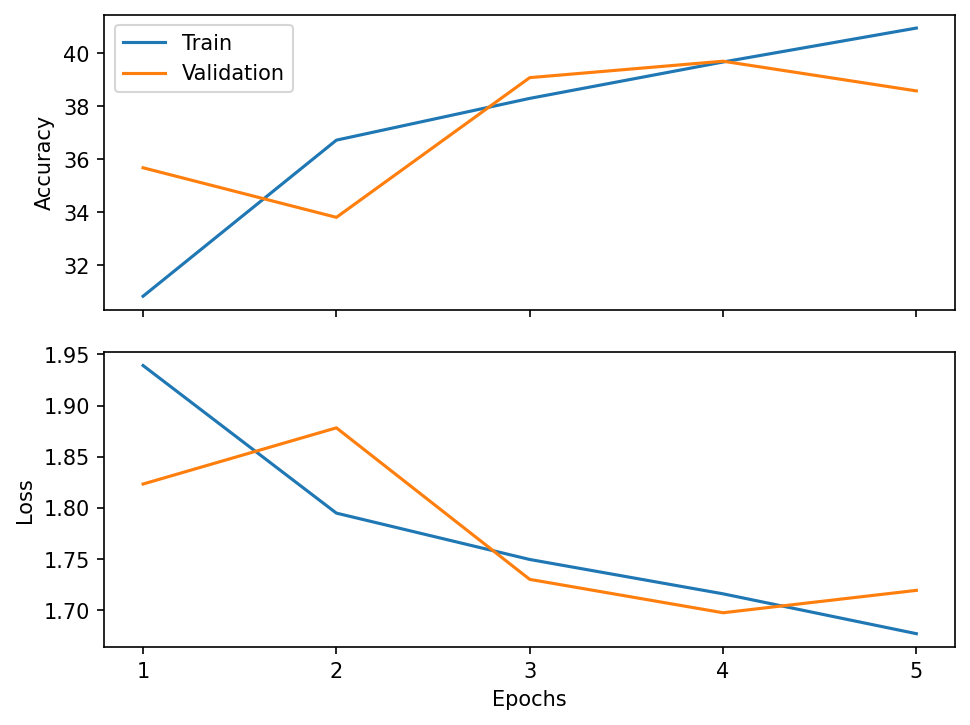

Test steps: 79 1.33s test_loss: 1.703005 test_acc: 39.110000                                
Exactitude en test: 39.11


In [42]:
initialize_network(tanh_network, init.xavier_uniform_)

history = train(tanh_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(tanh_network, cifar_test, batch_size)))

Regardons maintenant l'histogramme des gradients du réseau entraîné avec l'initialisation Xavier.

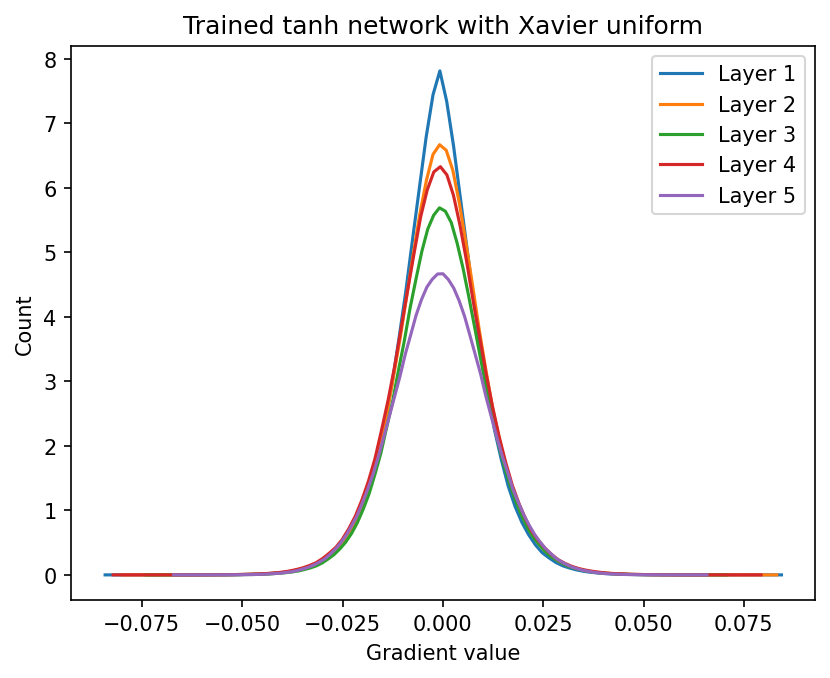

In [43]:
plot_gradient(tanh_network)
plt.title('Trained tanh network with Xavier uniform')
plt.show()

Entraînons le réseau avec l'initialisation Kaiming.

Epoch: 1/5 Train steps: 313 Val steps: 79 7.96s loss: 1.947767 acc: 30.332500 val_loss: 1.856950 val_acc: 32.110000
Epoch: 2/5 Train steps: 313 Val steps: 79 8.05s loss: 1.717106 acc: 38.782500 val_loss: 1.699796 val_acc: 38.500000
Epoch: 3/5 Train steps: 313 Val steps: 79 7.42s loss: 1.625150 acc: 42.435000 val_loss: 1.666434 val_acc: 40.200000
Epoch: 4/5 Train steps: 313 Val steps: 79 7.99s loss: 1.566210 acc: 44.612500 val_loss: 1.619174 val_acc: 41.060000
Epoch: 5/5 Train steps: 313 Val steps: 79 7.94s loss: 1.516857 acc: 46.322500 val_loss: 1.597199 val_acc: 42.770000


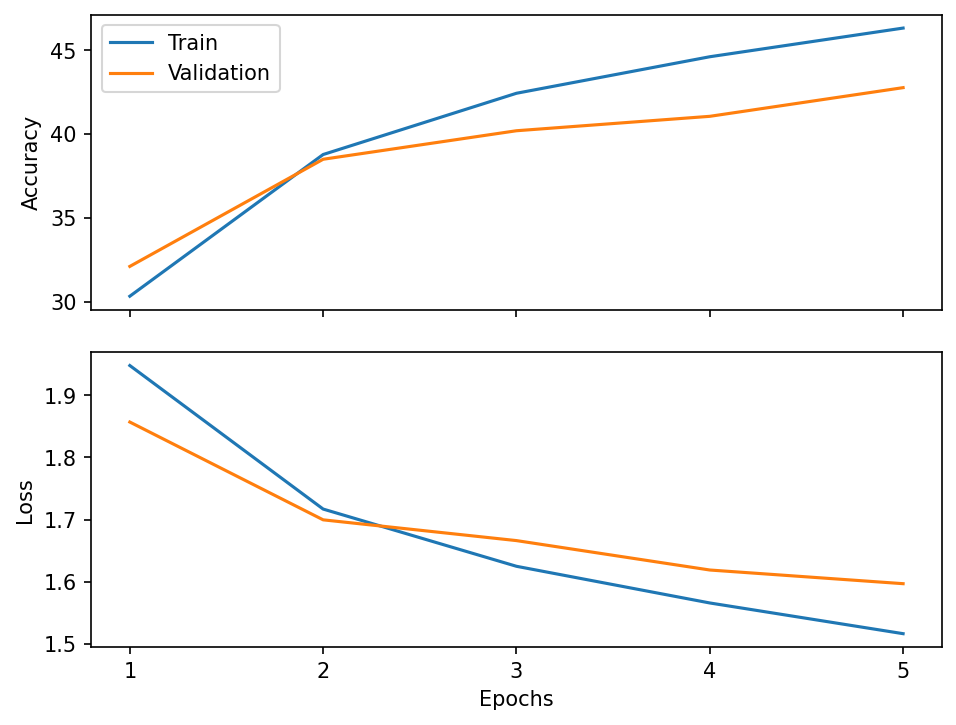

Test steps: 79 1.30s test_loss: 1.582111 test_acc: 43.090000                                
Exactitude en test: 43.09


In [44]:
initialize_network(tanh_network, init.kaiming_uniform_)

history = train(tanh_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(tanh_network, cifar_test, batch_size)))

Regardons maintenant l'histogramme des gradients du réseau entraîné avec l'initialisation Kaiming.

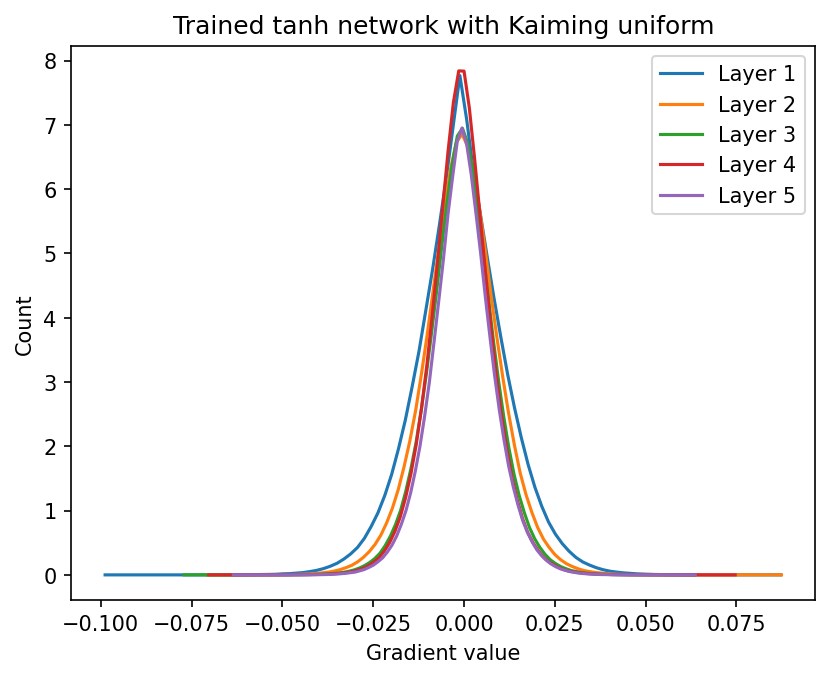

In [45]:
plot_gradient(tanh_network)
plt.title('Trained tanh network with Kaiming uniform')
plt.show()

#### Questions
- Que notez-vous en termes de performances des différentes techniques d'initialisation ? Plus les gradients sont uniformes à l'initialisation, plus le réseau apprendra.
- Comparez les graphiques pour les initialisations Xavier et Kaiming avant et après entraînement. Que remarquez-vous ? Les gradients convergent vers une variance d'une valeur d'environ 0.025, donc les distributions se resserrent au cours de l'entraînement et convergent au même endroit environ pour les différentes couches.

### 4.2 Réseau avec activation ReLU

Effectuons donc le même processus mais c'est fois-ci avec la fonction ReLU.

>Notons que la fonction calculant les histogrammes enlève tous les gradients qui sont exactement à zéro. Autrement, chaque histogramme aurait un grand pic à zéro nous empêchant de voir la distribution du reste des gradients.

In [46]:
relu_network = create_fully_connected_network('relu')
relu_network

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=3072, out_features=1000, bias=True)
  (2): ReLU()
  (3): Linear(in_features=1000, out_features=1000, bias=True)
  (4): ReLU()
  (5): Linear(in_features=1000, out_features=1000, bias=True)
  (6): ReLU()
  (7): Linear(in_features=1000, out_features=1000, bias=True)
  (8): ReLU()
  (9): Linear(in_features=1000, out_features=1000, bias=True)
  (10): ReLU()
  (11): Linear(in_features=1000, out_features=10, bias=True)
)

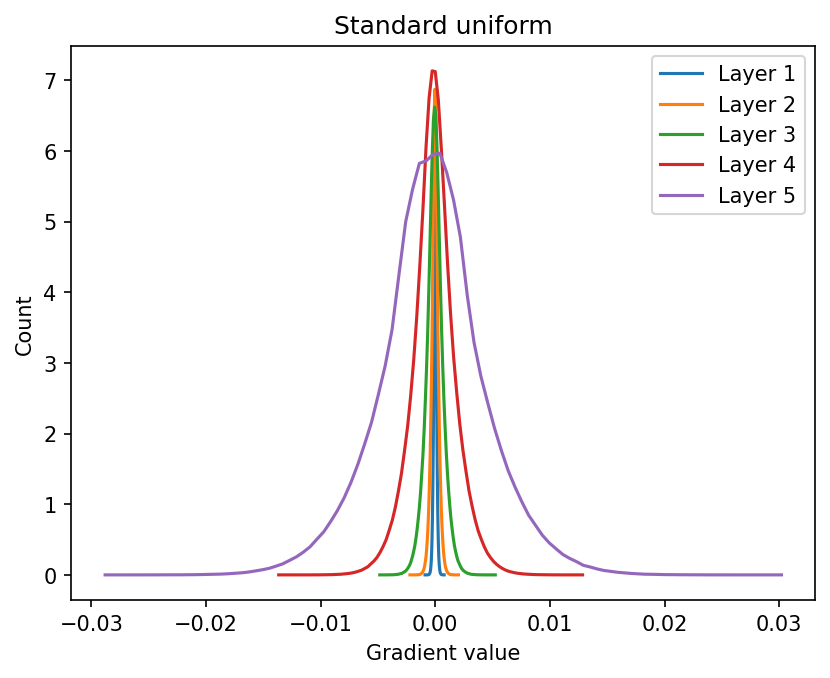

In [47]:
initialize_network(relu_network, standard_uniform)

plot_gradient(relu_network)
plt.title('Standard uniform')
plt.show()

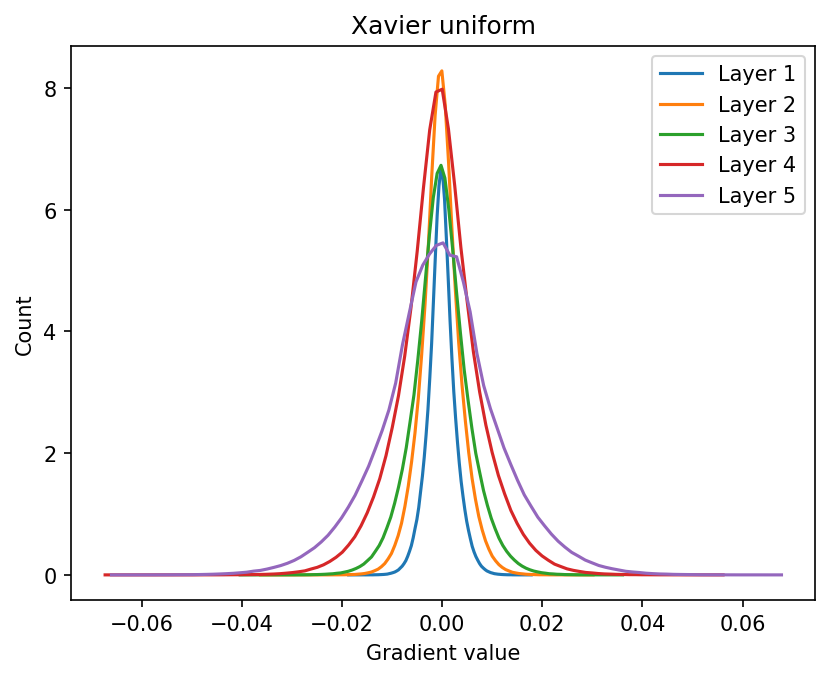

In [48]:
initialize_network(relu_network, init.xavier_uniform_)

plot_gradient(relu_network)
plt.title('Xavier uniform')
plt.show()

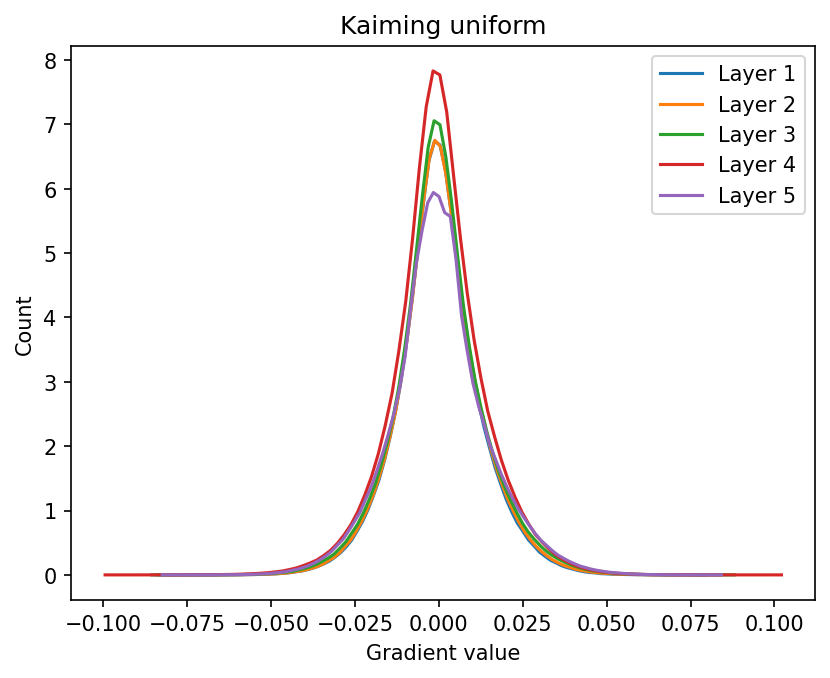

In [49]:
initialize_network(relu_network, init.kaiming_uniform_)

plot_gradient(relu_network)
plt.title('Kaiming uniform')
plt.show()

Effectuons les entraînements avec les différentes fonctions d'initialisation.

Epoch: 1/5 Train steps: 313 Val steps: 79 7.56s loss: 2.301747 acc: 11.115000 val_loss: 2.300746 val_acc: 16.890000
Epoch: 2/5 Train steps: 313 Val steps: 79 8.11s loss: 2.299390 acc: 18.380000 val_loss: 2.297910 val_acc: 18.930000
Epoch: 3/5 Train steps: 313 Val steps: 79 8.09s loss: 2.295012 acc: 19.122500 val_loss: 2.291438 val_acc: 16.160000
Epoch: 4/5 Train steps: 313 Val steps: 79 7.45s loss: 2.282607 acc: 15.625000 val_loss: 2.269647 val_acc: 15.820000
Epoch: 5/5 Train steps: 313 Val steps: 79 8.13s loss: 2.233941 acc: 16.417500 val_loss: 2.184075 val_acc: 19.420000


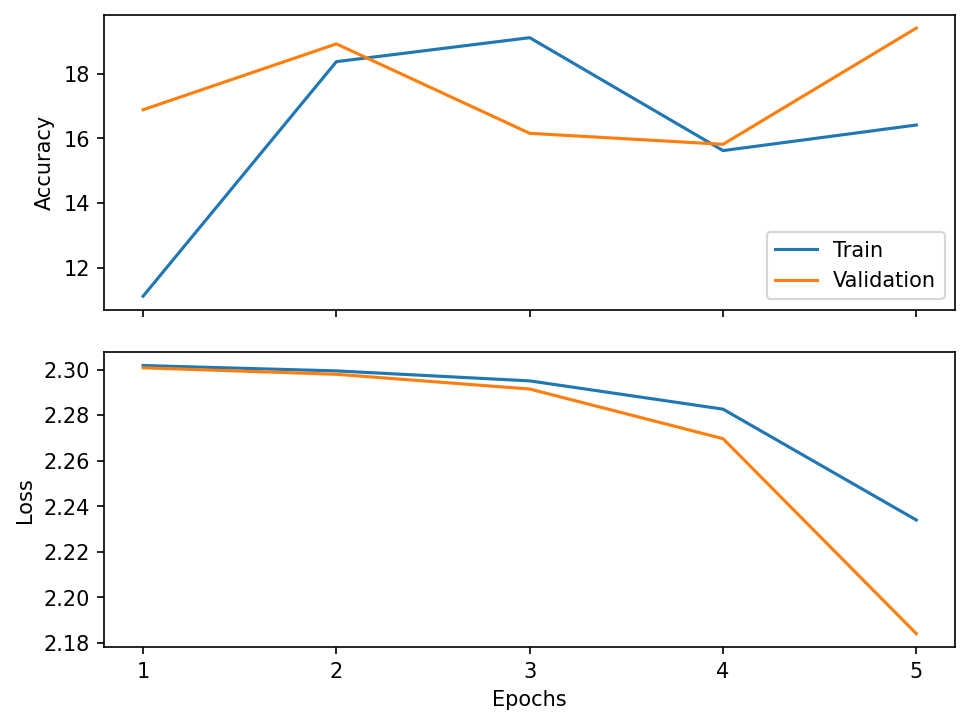

Test steps: 79 1.35s test_loss: 2.183465 test_acc: 18.980000                                
Exactitude en test: 18.98


In [50]:
initialize_network(relu_network, standard_uniform)

history = train(relu_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(relu_network, cifar_test, batch_size)))

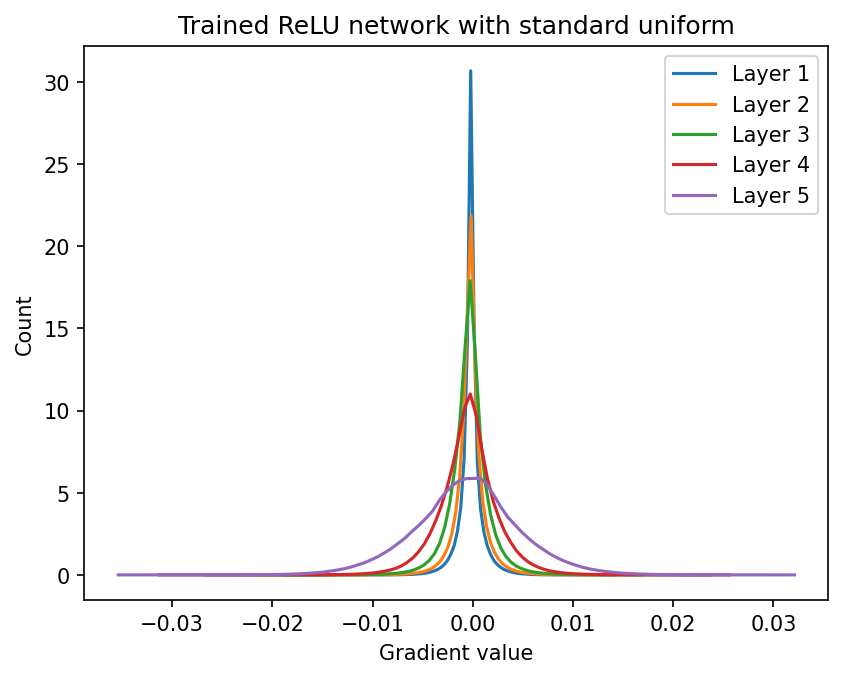

In [51]:
plot_gradient(relu_network)
plt.title('Trained ReLU network with standard uniform')
plt.show()

Epoch: 1/5 Train steps: 313 Val steps: 79 8.07s loss: 2.078169 acc: 25.497500 val_loss: 1.919243 val_acc: 31.200000
Epoch: 2/5 Train steps: 313 Val steps: 79 8.10s loss: 1.872221 acc: 33.012500 val_loss: 1.829301 val_acc: 34.370000
Epoch: 3/5 Train steps: 313 Val steps: 79 7.50s loss: 1.783675 acc: 36.795000 val_loss: 1.802384 val_acc: 36.210000
Epoch: 4/5 Train steps: 313 Val steps: 79 8.11s loss: 1.726968 acc: 38.872500 val_loss: 1.743502 val_acc: 37.610000
Epoch: 5/5 Train steps: 313 Val steps: 79 8.10s loss: 1.677338 acc: 40.722500 val_loss: 1.718456 val_acc: 38.000000


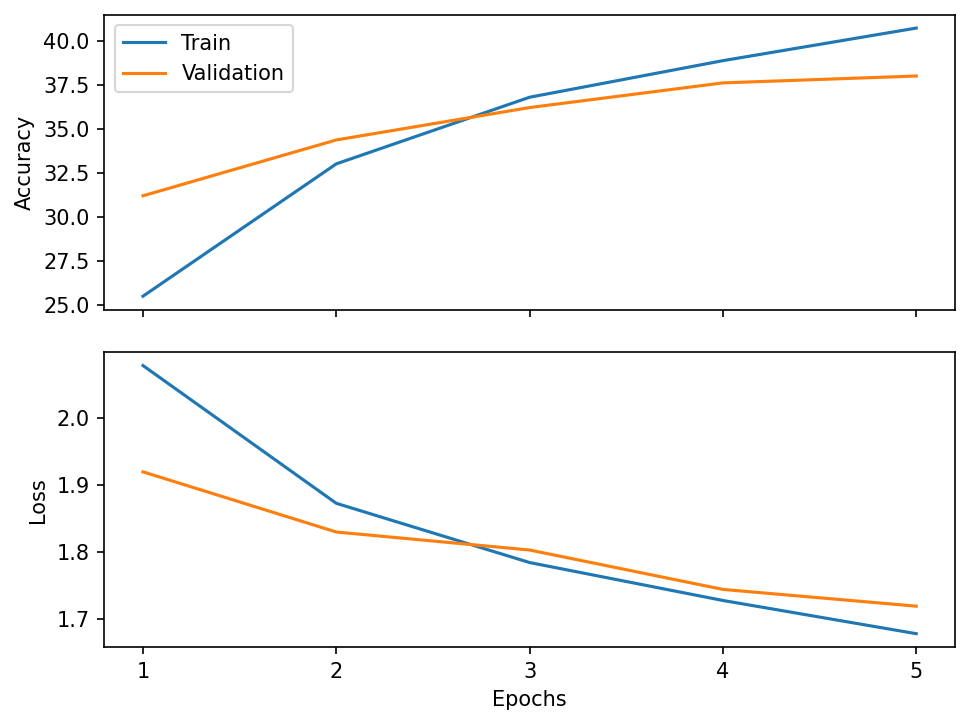

Test steps: 79 1.34s test_loss: 1.712160 test_acc: 38.510000                                
Exactitude en test: 38.51


In [52]:
initialize_network(relu_network, init.xavier_uniform_)

history = train(relu_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(relu_network, cifar_test, batch_size)))

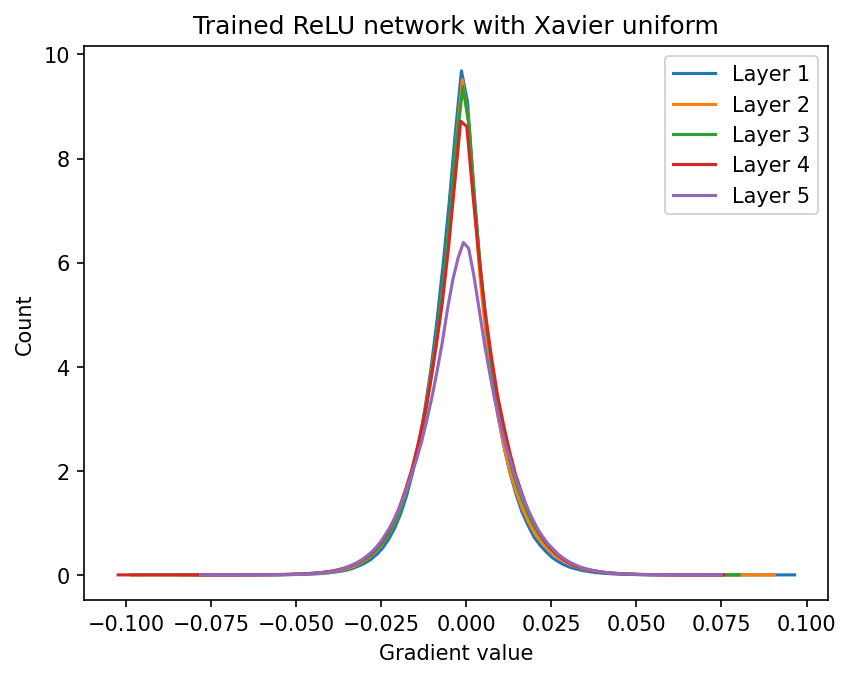

In [53]:
plot_gradient(relu_network)
plt.title('Trained ReLU network with Xavier uniform')
plt.show()

Epoch: 1/5 Train steps: 313 Val steps: 79 8.16s loss: 1.917957 acc: 31.130000 val_loss: 1.942289 val_acc: 30.270000
Epoch: 2/5 Train steps: 313 Val steps: 79 7.54s loss: 1.727290 acc: 38.725000 val_loss: 1.727515 val_acc: 38.110000
Epoch: 3/5 Train steps: 313 Val steps: 79 8.02s loss: 1.649498 acc: 41.752500 val_loss: 1.638827 val_acc: 41.860000
Epoch: 4/5 Train steps: 313 Val steps: 79 8.16s loss: 1.585215 acc: 44.235000 val_loss: 1.603527 val_acc: 43.620000
Epoch: 5/5 Train steps: 313 Val steps: 79 7.47s loss: 1.546865 acc: 45.182500 val_loss: 1.581668 val_acc: 43.280000


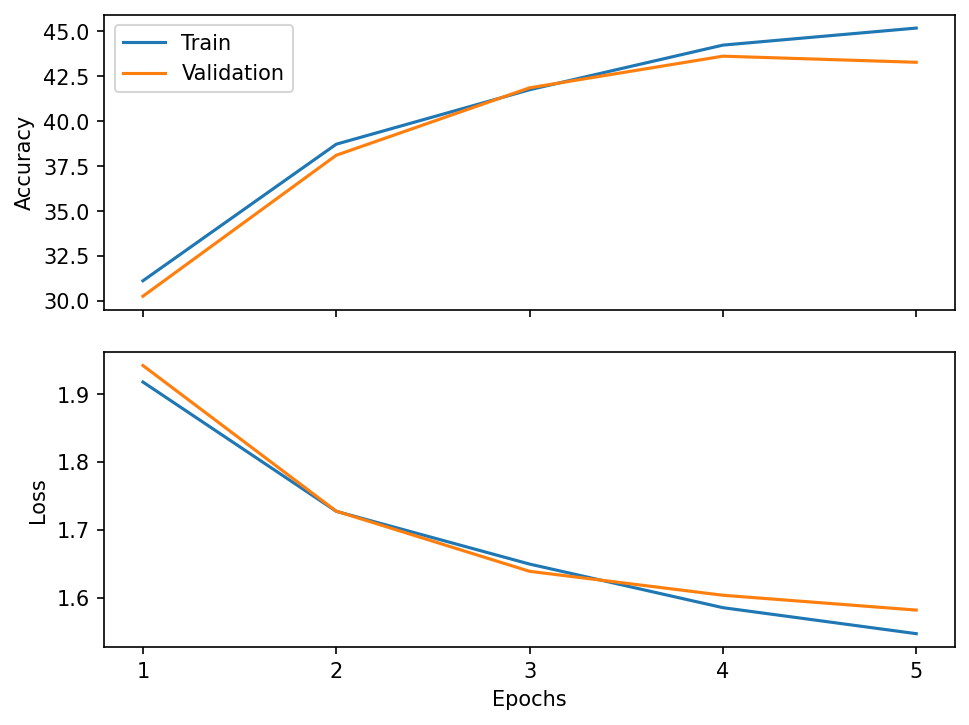

Test steps: 79 1.34s test_loss: 1.572976 test_acc: 43.610000                                
Exactitude en test: 43.61


In [54]:
initialize_network(relu_network, init.kaiming_uniform_)

history = train(relu_network, 'sgd', cifar_train, epochs, batch_size)
history.display()
print('Exactitude en test: {:.2f}'.format(test(relu_network, cifar_test, batch_size)))

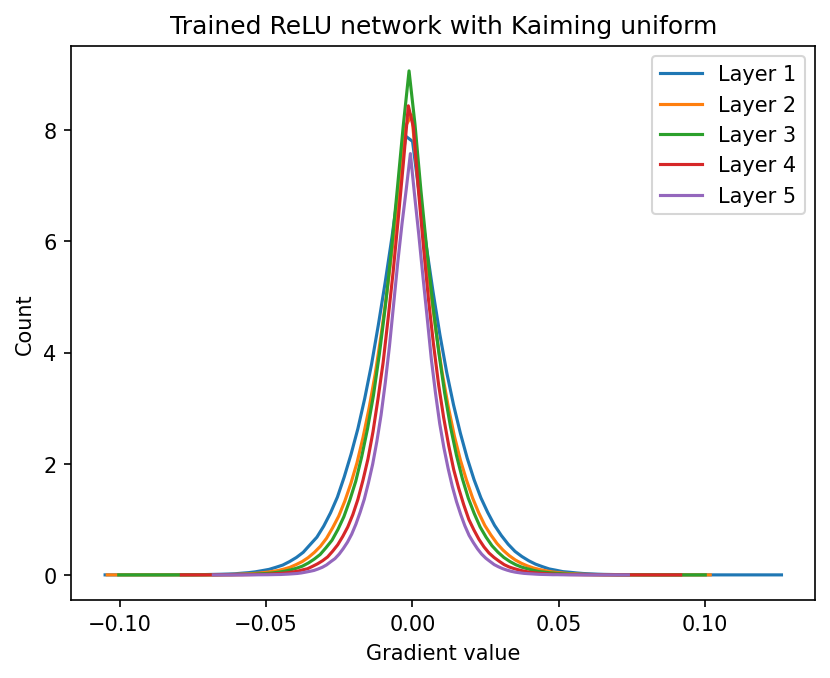

In [55]:
plot_gradient(relu_network)
plt.title('Trained ReLU network with Kaiming uniform')
plt.show()

#### Questions
- Quelles similarités remarquez-vous en termes de performance et de gradient entre le réseau avec activation tanh et le réseau avec activation ReLU ? Pour les initialisations Xavier et Kaiming, les réseaux apprennent assez bien et les gradients de toutes les couches convergent vers des variances similaires.
- Quelles différences remarquez-vous en termes de performance et de gradient entre le réseau avec activation tanh et le réseau avec activation ReLU ?
Pour l'initialisation standard, le réseau apprend à peine et comme le ReLU ne propage pas toujours de gradient, ce ne sont pas toutes les couches qui convergent vers la même variance au niveau des gradients.